# Assignment #4 - Reinforcement Learning

### <font color="red"> DUE: Apr 16 (Tuesday) 11:00 pm </font>  

<font color="blue"> Srishti Tiwari </font>

# I. Overview

The objective of this assignment is to learn Reinforcement Learning and to build RL Agent for solving BlackJack problem. The BlackJack environment is created using the modified Open AI gym implementation of BlackJackEnv class. An agent is built and trained for environment using Q-Learning.

The Goal of the RL Agent for BlackJack problem would be to make decision whether to draw a card or not and to win the game.

# II. Problems 



## Blackjack

<img src="https://upload.wikimedia.org/wikipedia/commons/a/a2/Blackjack_game_1.JPG" width=800 />

Now, we play Blackjack! 
We have improved version of it from OpenAI Gym [Blackjack-V0](https://gym.openai.com/envs/Blackjack-v0/). Our blackjack has an additional betting option. Here follows the rule description. 


### <font color="red"> Game Introduction and Rules: </font>


Blackjack is a card game where the goal is to obtain cards that sum to as
near as possible to 21 without going over.  They're playing against a fixed
dealer.

Face cards (Jack, Queen, King) have point value 10.
Aces can either count as 11 or 1, and it's called 'usable' at 11.
This game is placed with an infinite deck (or with replacement).

The game starts with each player getting two face up cards and dealer
having one face up and face down card and the player needs to bet an 
amount of money within range of 1 to max bet (10). 
Note: Face up means that you will know what the card is.

The player can request additional cards (hit=1) until they decide to stop
(stick=0) or exceed 21 (bust).

After the player sticks, the dealer reveals their facedown card, and draws
until their sum is 17 or greater (fixed policy).  If the dealer goes bust the player wins.
You won't see the dealer's facedown card, just you will know if you have or lost
and you will get appropriate reward of +1 if you win, -1 if you loose or 0 if the match
is drawn.
(It is freedom of choice for you to change the reward function. If you want to change, you should explain the reason of the change.)

If the player wins, the amount he has bet will be doubled and given back. 
If the player and dealer have the same sum, then its a draw and the player will get
back the money he has bet. 
If the player loses then, the money he bet will be lost. 
If neither player nor dealer busts, the outcome (win, lose, draw) is
decided by whose sum is closer to 21. You are free to change the reward function to make it 
learn more efficiently. (i.e.,  the amount of money the user is winning after each round). 

Regardless of the number of players on the table, each player will be just playing against the 
dealer independently of the other players.

## BlackJack Environment

In [1]:
import collections
import numpy as np
import matplotlib.pyplot as plt
import gym
from gym import spaces
from gym.utils import seeding
%matplotlib inline

### Player class definition

Player class defines an object for each BlackJack player with a given *unique* name. It has three attributes, the player's name, current cards in hand, and total balance left to play games.  <code>get_info()</code> is getter method that prints out all three attributes.

In [2]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10)
        Above declaration will be for your agent.
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10):
        self.player_name = player_name
        self.card = []
        self.starter_balance = start_balance
        self.total_balance = start_balance

    def recharge_account(self):
        self.total_balance = self.starter_balance
        
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))     

Following functions are utilities and definition of card deck to play games and to check the game status. 

In [3]:
# 1 = Ace, 2-10 = Number cards, Jack/Queen/King = 10
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 10, 10, 10]

def cmp(a, b):
    return float(a > b) - float(a < b)

def draw_card(np_random):
    return int(np_random.choice(deck))

def draw_hand(np_random):
    return [draw_card(np_random), draw_card(np_random)]


def usable_ace(hand):  # Does this hand have a usable ace?
    return 1 in hand and sum(hand) + 10 <= 21


def sum_hand(hand):  # Return current hand total
    if usable_ace(hand):
        return sum(hand) + 10
    return sum(hand)


def is_bust(hand):  # Is this hand a bust?
    return sum_hand(hand) > 21


def score(hand):  # What is the score of this hand (0 if bust)
    return 0 if is_bust(hand) else sum_hand(hand)


def is_natural(hand):  # Is this hand a natural blackjack?
    return sorted(hand) == [1, 10]

### Game Environment

The Blackjack game environment is defined as follows. Inheriting, OpenAI.Gym.Env, it overrides the interfances to enable the interfaction with the same interfaces with other OpenAI Gym environments. 

These are important member functions to be used by you:
1. add_player: You can add your player object with some initial amount of money

2. step: you need to send the action using this function, actions are hit(1) or stand(0)
        returns {'state': player info and dealer info (_get_obs), 
                 'reward': real-valued reward, 
                 'is_round_done': True/Fasle}
3. _get_obs: returns the state of the env or required information you can use to build your agent. 
             eg: {'player_info':{'player_sum_card': sum of cards, 
                                 'player_card': list of cards, 
                                 'player_total_balance': real-valued number, 
                                 'usable_ace' : True/False}, 
                 'dealer_info': dealer's first card}
4. init_round: will start a new round in the same game.
        returns {'state': player info and dealer info (_get_obs)}
          
5. reset: will reset the whole game and you will being again with the initial balance you had started the player object.
        returns nothing, will just reset the entire game.
          
6. bet_money: you can bet the amount using this method, takes in the money between (1, max_bet_cap). max_bet_cap is 10. 
        returns nothing.


### Blackjack Class 

BlackjackEnv is the environment creator for the BlackJack simulator.This class uses **gym** library. This class uses various methods like draw_card(), draw_hand(),usable_ace(),is_bust (),etc. but the important method is the step() method which takes in action as the input and returns next observation,reward, etc. back to the user.This method is changed a little than the one available in the Open AI gym.

In [4]:


class BlackjackEnv(gym.Env):
    """
    Simple blackjack environment
    
    Blackjack is a card game where the goal is to obtain cards that sum to as
    near as possible to 21 without going over.  They're playing against a fixed
    dealer.
    Face cards (Jack, Queen, King) have point value 10.
    Aces can either count as 11 or 1, and it's called 'usable' at 11.
    This game is placed with an infinite deck (or with replacement).
    The game starts with each (player and dealer) having one face up and one
    face down card.
    The player can request additional cards (hit=1) until they decide to stop
    (stick=0) or exceed 21 (bust).
    After the player sticks, the dealer reveals their facedown card, and draws
    until their sum is 17 or greater.  If the dealer goes bust the player wins.
    If neither player nor dealer busts, the outcome (win, lose, draw) is
    decided by whose sum is closer to 21.  The reward for winning is +1,
    drawing is 0, and losing is -1.
    The observation is: the players current sum, players current card, players balance left, 
    the dealer's one showing card (1-10 where 1 is ace),
    and whether or not the player holds a usable ace (0 or 1).
    
    Parameters
    ==========
    natural      boolean
                 option for 50% more reward on natural blackjack 
    
    """
    
    def __init__(self, natural=False):
        self.action_space = spaces.Discrete(2)
        self.observation_space = spaces.Tuple((
            spaces.Discrete(32),
            spaces.Discrete(11),
            spaces.Discrete(2)))
        self.seed()
        self.total_players = 1
        self.players = {}
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}
        self.max_bet_cap = 10

    def add_player(self, player_class):
        if player_class not in self.players and len(self.players) < self.total_players:
            self.players[player_class.player_name] = player_class
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.players)))

    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def step(self, player_name, action):
        assert self.action_space.contains(action)
        if action:  # hit: add a card to players hand and return
            self.players[player_name].card.append(draw_card(self.np_random))
            if is_bust(self.players[player_name].card):
                done = True
                reward = -1
            else:
                done = False
                reward = 0
        else:  # stick: play out the dealers hand, and score
            done = True
            while sum_hand(self.dealer) < 17:
                self.dealer.append(draw_card(self.np_random))
            reward = cmp(score(self.players[player_name].card), score(self.dealer))
            if self.natural and is_natural(self.players[player_name].card) and reward == 1:
                reward = 1.5
        if done:
            self.settle_balance(int(reward), player_name)
        return {'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}

    def _get_obs(self, player_name):
        return {'player_info':self.get_player_obs(player_name), 
                'dealer_info': self.dealer[0]}

    def get_player_obs(self, player_name):
        return {'player_sum_card':sum_hand(self.players[player_name].card), 
                'player_card':self.players[player_name].card, 
                'player_total_balance':self.players[player_name].total_balance, 
                'usable_ace' : usable_ace(self.players[player_name].card)}
    
    def get_valid_bet_amount(self, player_name):
        print("player name: {} money left: {}".format(player_name, self.players[player_name].total_balance))
        if self.players[player_name].total_balance < 1:
            return {'is_round_done': True, 'valid_bet_amount': -1}
        max_bet_upper_limit = self.players[player_name].total_balance
        if self.players[player_name].total_balance >= self.max_bet_cap:
            max_bet_upper_limit = self.max_bet_cap            
        return {'is_round_done': False, 'valid_bet_amount': list(range(1, max_bet_upper_limit+1))}
            
    def init_round(self, player_name):         
        self.dealer = draw_hand(self.np_random)
        self.players[player_name].card = draw_hand(self.np_random)
        return {'state': self._get_obs(player_name)}        

    def bet_money(self, player_name, bet_amount):
        self.players[player_name].total_balance -= bet_amount
        self.round_bet_info[player_name] = bet_amount
            
    def settle_balance(self, is_winner, player_name):
        if is_winner == 1:
            print("player winner")
            self.players[player_name].total_balance += (2 * self.round_bet_info[player_name])
        elif is_winner == 0:
            print("Draw match")
            self.players[player_name].total_balance += self.round_bet_info[player_name]
        else:
            print("player loser, wont get back the money, try next round")
    
    def reset(self, natural=False):
        for player_name, player_class in self.players.items():
            player_class.recharge_account()
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}


### Example Run with Random Players

This following code shows how to create an environment and players to play 10 games with 20 maximum rounds. This only includes random betting and random hit/stick decision making. 

In [5]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)
#Number of games
number_of_games = 10

#Number of rounds
number_of_rounds = 20

for _game in range(number_of_games):

    env.reset()
    print("-"* 75)
    print("Game No.: {}".format(_game + 1))
    print("-"* 75)
    for _round in range(number_of_rounds): 
        print("%"* 75)
        print("Game No.: {} Round No.: {}".format(_game+1, _round+1))
        print("%"* 75)
        
        #Check if you have enough money left in the account to bet, if not break and start a new game
        valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
        if valid_bet_flag['is_round_done']:
            print("You are out of money ! Will go to next game !!")
            break
        bet_amount = valid_bet_flag['valid_bet_amount']
        
        #Get the observations i.e state and use it to decide how much you want to bet
        round_obs = env.init_round(player1.player_name)
        print("Initial state: {}".format(round_obs))  
        
        # If you have just $1 left in the bank, you have no choice but to bet that amount 
        # and hopefully leave it to the fate for your agent to win and continue playing or just
        # start a new game
        if len(bet_amount) == 1 and bet_amount[0] == 1:
            print("You can only bet 1. So betting only 1.")
            random_bet = 1
        else:
            random_bet = np.random.choice(bet_amount)
        print("Random Init Bet: {}".format(random_bet))
        env.bet_money(player1.player_name, random_bet)
          
        
        # Look at the state and take actions, here the actions are selected randomly
        # you can use the agent to select the action
        random_action = np.random.randint(0, 2)
        print("Action taken: {}".format(random_action))

        #Use the selected action to actually take the action in env by calling step
        round_obs = env.step(player1.player_name, random_action)
        print("State after 1st action: {}".format(round_obs))

        #Check if the game is not over, if your action is stand then the game is over, else
        #the game continues in this loop until your action is stand
        while not round_obs['is_round_done']:
            #Select an random action and take the action
            random_action = np.random.randint(0, 2)
            print("Action taken: {}".format(random_action))
            round_obs = env.step(player1.player_name, random_action)
            print("State after nth action: {}".format(round_obs))

        #Round over, but the game will continue untill you have exhausted your initial money 
        print("Balance Left: {}".format(round_obs['state']['player_info']['player_total_balance']))
        print("Round over")
        print("-%-"*30)
        if (_round + 1) == (number_of_rounds):
            print("Max number of rounds played. If you see this message, you are the winner.")

---------------------------------------------------------------------------
Game No.: 1
---------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game No.: 1 Round No.: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Random Init Bet: 10
Action taken: 1
player loser, wont get back the money, try next round
State after 1st action: {'state': {'player_info': {'player_sum_card': 30, 'player_card': [10, 10, 10], 'player_total_balance': 0, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1, 'is_round_done': True}
Balance Left: 0
Round over
-%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%--%-
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

# III. Methods

- Decide your TD learning approach: SARSA or Q-learning? 
- Decide your function approximator.
- Describe your approach and the reason why you select it.
- Explain your codes.

## Temporal Difference Learning

Temporal Difference (TD) Learning methods can be used to estimate these value functions. If the value functions were to be calculated without estimation, the agent would need to wait until the final reward was received before any state-action pair values can be updated. Once the final reward was received, the path taken to reach the final state would need to be traced back and each value updated accordingly. This can be expressed formally as: 

$$
{\displaystyle V(s)\leftarrow V(s)+\alpha (\overbrace {r+\gamma V(s')} ^{\text{The TD target}}-V(s))}
$$

## On-Policy and Off-Policy Learning

On-Policy Temporal Difference methods learn the value of the policy that is used to make decisions. The value functions are updated using results from executing actions determined by some policy. These policies are usually "soft" and non-deterministic. The meaning of "soft" in this sense, is that it ensures there is always an element of exploration to the policy. The policy is not so strict that it always chooses the action that gives the most reward. Three common policies are used,  -soft, -greedy and softmax. These are explained in the section below.

Off-Policy methods can learn different policies for behaviour and estimation. Again, the behaviour policy is usually "soft" so there is sufficient exploration going on. Off-policy algorithms can update the estimated value functions using hypothetical actions, those which have not actually been tried. This is in contrast to on-policy methods which update value functions based strictly on experience. What this means is off-policy algorithms can separate exploration from control, and on-policy algorithms cannot. In other words, an agent trained using an off-policy method may end up learning tactics that it did not necessarily exhibit during the learning phase.



## Action Selection Policies

As mentioned above, there are three common policies used for action selection. The aim of these policies is to balance the trade-off between exploitation and exploration, by not always exploiting what has been learnt so far.

-greedy - most of the time the action with the highest estimated reward is chosen, called the greediest action. Every once in a while, say with a small probability , an action is selected at random. The action is selected uniformly, independant of the action-value estimates. This method ensures that if enough trials are done, each action will be tried an infinite number of times, thus ensuring optimal actions are discovered.
-soft - very similar to  -greedy. The best action is selected with probability 1 -   and the rest of the time a random action is chosen uniformly.
softmax - one drawback of  -greedy and -soft is that they select random actions uniformly. The worst possible action is just as likely to be selected as the second best. Softmax remedies this by assigning a rank or weight to each of the actions, according to their action-value estimate. A random action is selected with regards to the weight associated with each action, meaning the worst actions are unlikely to be chosen. This is a good approach to take where the worst actions are very unfavourable.
It is not clear which of these policies produces the best results overall. The nature of the task will have some bearing on how well each policy influences learning. If the problem we are trying to solve is of a game playing nature, against a human opponent, human factors may also be influencial.

## 1. Q-Learning

Q-Learning is an Off-Policy algorithm for Temporal Difference learning. It can be proven that given sufficient training under any  -soft policy, the algorithm converges with probability 1 to a close approximation of the action-value function for an arbitrary target policy. Q-Learning learns the optimal policy even when actions are selected according to a more exploratory or even random policy. 

### Algorithm

* Initialize the Q-values table, Q(s, a).
* Observe the current state, s.
* Choose an action, a, for that state based on one of the action selection policies explained here on the previous page (-soft,  -greedy or softmax).
* Take the action, and observe the reward, r, as well as the new state, s'.
* Update the Q-value for the state using the observed reward and the maximum reward possible for the next state. 
* The updating is done according to the forumla and parameters described above.
* Set the state to the new state, and repeat the process until a terminal state is reached.



## 2. Sarsa

The Sarsa algorithm is an On-Policy algorithm for TD-Learning. The major difference between it and Q-Learning, is that the maximum reward for the next state is not necessarily used for updating the Q-values. Instead, a new action, and therefore reward, is selected using the same policy that determined the original action. The name Sarsa actually comes from the fact that the updates are done using the quintuple Q(s, a, r, s', a'). Where: s, a are the original state and action, r is the reward observed in the following state and s', a' are the new state-action pair.

### Algorithm
$$
{\displaystyle Q(s_{t},a_{t})\leftarrow Q(s_{t},a_{t})+\alpha [r_{t}+\gamma Q(s_{t+1},a_{t+1})-Q(s_{t},a_{t})]}
$$
A SARSA agent interacts with the environment and updates the policy based on actions taken, hence this is known as an on-policy learning algorithm. The Q value for a state-action is updated by an error, adjusted by the learning rate alpha. Q values represent the possible reward received in the next time step for taking action a in state s, plus the discounted future reward received from the next state-action observation.

Watkin's Q-learning updates an estimate of the optimal state-action value function $$ Q^{*} $$ based on the maximum reward of available actions. While SARSA learns the Q values associated with taking the policy it follows itself, Watkin's Q-learning learns the Q values associated with taking the optimal policy while following an exploration/exploitation policy.

Some optimizations of Watkin's Q-learning may be applied to SARSA.

### Hyperparameters
#### Learning rate (alpha)
The learning rate determines to what extent newly acquired information overrides old information. A factor of 0 will make the agent not learn anything, while a factor of 1 would make the agent consider only the most recent information.

#### Discount factor (gamma)
The discount factor determines the importance of future rewards. A factor of 0 makes the agent "opportunistic" by only considering current rewards, while a factor approaching 1 will make it strive for a long-term high reward. If the discount factor meets or exceeds 1, the Q values may diverge.

#### Initial conditions (Q(s0, a0))
Since SARSA is an iterative algorithm, it implicitly assumes an initial condition before the first update occurs. A low (infinite) initial value, also known as "optimistic initial conditions", can encourage exploration: no matter what action takes place, the update rule causes it to have higher values than the other alternative, thus increasing their choice probability. In 2013 it was suggested that the first reward r could be used to reset the initial conditions. According to this idea, the first time an action is taken the reward is used to set the value of Q. This allows immediate learning in case of fixed deterministic rewards. This resetting-of-initial-conditions (RIC) approach seems to be consistent with human behavior in repeated binary choice experiments.


## Choice of TD learning and Reason

* On-policy SARSA learns action values relative to the policy it follows, while off-policy Q-Learning does it relative to the greedy policy. 
* Under some common conditions, they both converge to the real value function, but at different rates. 
* Q-Learning tends to converge a little slower, but has the capabilitiy to continue learning while changing policies.

Because of above mentioned advantage with Q-learning, I decided to select q-learning.

## RLAgent for Blackjack

Referencing the RLAgent in the lecture note.
This Agent is implemented using the Q-learning approach. It uses a decaying-epsilon-greedy function. The 80% of the number of steps mentioned to train the Agent is used for decaying epsilon and the other 20% is used to train the agent using the greedy method.

This agent also maintains the Q-table in the form of a tuple like (sum_of_players_hand,dealers_face_up_card,Whether player has useable ace) : (action values).
While testing / Playing with the agent get_action() method is used which does not consider epsilon to choose the action rather than the choose_action() method which uses the decaying epsilon way to choose the next action.


In [6]:

import random

class RLAgent():
    def __init__(self, env,player, epsilon=1.0, alpha=0.5, gamma=0.9, num_episodes_to_train=30000):
        self.env = env
        self.player = player

        self.valid_actions = list(range(self.env.action_space.n))

        # Set parameters of the learning agent
        self.Q = dict()      # Q-table which will be a dictionary of tuples
        self.epsilon = 0     # Random exploration factor
        self.alpha = 0       # Learning factor
        self.gamma = 0       # Discount factor- closer to 1 learns well into distant future
        self.num_episodes_to_train = 0
    
    def init_decay(self,num_episodes_to_train):
        self.num_episodes_to_train = num_episodes_to_train
        self.small_decrement = (0.1 * self.epsilon) / (0.3 * self.num_episodes_to_train)
        self.big_decrement = (0.8 * self.epsilon) / (0.4 * self.num_episodes_to_train)

        self.num_episodes_to_train_left = self.num_episodes_to_train

    def update_parameters(self):
        if self.num_episodes_to_train_left > 0.7 * self.num_episodes_to_train:
            self.epsilon -= self.small_decrement
        elif self.num_episodes_to_train_left > 0.3 * self.num_episodes_to_train:
            self.epsilon -= self.big_decrement
        elif self.num_episodes_to_train_left > 0:
            self.epsilon -= self.small_decrement
        else:
            self.epsilon = 0.0
            self.alpha = 0.0

        self.num_episodes_to_train_left -= 1

    def create_Q_if_new_observation(self, observation):
        if observation not in self.Q:
            self.Q[observation] = dict((action, 0.0) for action in self.valid_actions)

    def get_maxQ(self, observation):
        self.create_Q_if_new_observation(observation)
        return max(self.Q[observation].values())

    def choose_action(self, observation):
        self.create_Q_if_new_observation(observation)
        if random.random() > self.epsilon:
            maxQ = self.get_maxQ(observation)
            action = random.choice([k for k in self.Q[observation].keys()
                                    if self.Q[observation][k] == maxQ])
        else:
            action = random.choice(self.valid_actions)

        self.update_parameters()

        return action
    
    def get_action(self, observation):
        self.create_Q_if_new_observation(observation)
        maxQ = self.get_maxQ(observation)
        return random.choice([k for k in self.Q[observation].keys()
                                if self.Q[observation][k] == maxQ])


    def qlearn(self, observation, action, reward, next_observation):
        self.Q[observation][action] += self.alpha * (reward
                                                     + (self.gamma * self.get_maxQ(next_observation))
                                                     - self.Q[observation][action])
        #print('Q-learning: ',self.Q)
        
    def train(self, **params):
        # parameters
        self.gamma = params.pop('gamma', 0.2)
        self.alpha = params.pop('alpha', 0.5)
        self.epsilon= params.pop('epsilon', 1.0)
        num_samples= params.pop('num_samples', 1000) 
        num_rounds= params.pop('num_rounds', 1000)
        num_episodes_to_train = params.pop('num_episodes_to_train',800)
        
        self.init_decay(num_episodes_to_train)
        
        average_payouts = []

        for sample in range(num_samples):
            #env.reset()
            bet_fl = True
            env.reset()
            obs = env.init_round(player1.player_name)
            #print(obs)
            a = obs['state']['player_info']['player_sum_card']
            b = obs['state']['dealer_info']
            c = obs['state']['player_info']['usable_ace']
            observation = (a,b,c)
            print('Initial state: ',observation)
            print('Initial bet',obs['state']['player_info']['player_total_balance'])
            round = 1
            total_payout = 0
            print('-'*100)
            print('Game number: ',sample)
            print('-'*100)
            while round <= num_rounds:
                print('%'*100)
                print('Round: ',round)
                if bet_fl:
                    #Check if you have enough money left in the account to bet, if not break and start a new game
                    valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
                    if valid_bet_flag['is_round_done']:
                        print("You have no money left ! Will go to next game !!")
                        break
                    bet_amount = valid_bet_flag['valid_bet_amount']

                    if len(bet_amount) == 1 and bet_amount[0] == 1:
                        print("You can bet only 1, so betting only 1.")
                        random_bet = 1
                    else:
                        random_bet = np.random.choice(bet_amount)
                    print("Random Initial Bet: {}".format(random_bet))
                    env.bet_money(player1.player_name, random_bet)
                    bet_fl = False
                action = agent.choose_action(observation)
                print('Action: ',action)
                round_obs = env.step(player1.player_name,action)
                #print('step function',round_obs)
                a1 = round_obs['state']['player_info']['player_sum_card']
                b1 = round_obs['state']['dealer_info']
                c1 = round_obs['state']['player_info']['usable_ace']
                next_observation = (a1,b1,c1)
                payout = round_obs['reward']
                is_done= round_obs['is_round_done']
                print('Remaining bet',round_obs['state']['player_info']['player_total_balance'])
                print("State after 1st action: {}".format(next_observation))
                print('Next observation',next_observation)
                
                self.qlearn(observation, action, payout, next_observation)
                
                total_payout += payout
                observation = next_observation
                if is_done:
                    #observation = env.reset()
                    obs = env.init_round(player1.player_name)
                    #print(obs)
                    a = obs['state']['player_info']['player_sum_card']
                    b = obs['state']['dealer_info']
                    c = obs['state']['player_info']['usable_ace']
                    observation = (a,b,c)
                    print('Initial state: ',observation)
                    round += 1
                    bet_fl = True
            average_payouts.append(total_payout)
        return average_payouts
    
    def test(self, **params):

        #average_payouts = []

        env.reset()
        obs = env.init_round(player1.player_name)
        #print(obs)
        a = obs['state']['player_info']['player_sum_card']
        b = obs['state']['dealer_info']
        c = obs['state']['player_info']['usable_ace']
        observation = (a,b,c)
        print('Initial state: ',observation)
        total_payout = 0
        is_done = False
        while not is_done:
            print('-'*100)
            valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
            if valid_bet_flag['is_round_done']:
                print("You have no money left! Will go to next game !!")
                break
            bet_amount = valid_bet_flag['valid_bet_amount']

            if len(bet_amount) == 1 and bet_amount[0] == 1:
                print("You can bet only 1, so betting only 1.")
                random_bet = 1
            else:
                random_bet = np.random.choice(bet_amount)
            print("Random Initial Bet: {}".format(random_bet))
            env.bet_money(player1.player_name, random_bet)
            action = agent.get_action(observation)
            print('Action: ',action)
            if(action == 0):
                print("Stay")
            else:
                print("Hit")
            round_obs = env.step(player1.player_name,action)
            #print('step function',round_obs)
            a1 = round_obs['state']['player_info']['player_sum_card']
            b1 = round_obs['state']['dealer_info']
            c1 = round_obs['state']['player_info']['usable_ace']
            next_observation = (a1,b1,c1)
            payout = round_obs['reward']
            is_done= round_obs['is_round_done']
            print("State after 1st action: {}".format(next_observation))
            print('next obs',next_observation)
            total_payout += payout
            observation = next_observation
            if is_done:
                #observation = env.reset()
                obs = env.init_round(player1.player_name)
                #print(obs)
                a = obs['state']['player_info']['player_sum_card']
                b = obs['state']['dealer_info']
                c = obs['state']['player_info']['usable_ace']
                observation = (a,b,c)
        return total_payout
    
    def readable_action(self,observation):
        """ 
        Pass observation to agent and get human readable action
        H is hit, S is stick and '-' means the state is unseen and a random action is taken
        """
        if observation not in self.Q:
            action = "-"
        else:
            action = "H" if self.get_action(observation) else "S"    
        return action

### To plot the results, I have plotted number of samples against payout after 1000 rounds

In [7]:
def plt_result(average_payouts,agent):
    plot_avg_reward(average_payouts)
      
def plot_avg_reward(average_payouts):
    plt.plot(average_payouts)           
    plt.xlabel('num_samples')
    plt.ylabel('payout after 1000 rounds')
    plt.show()      
    print ("Average payout after {} rounds is {}".format(num_rounds, sum(average_payouts)/(num_samples)))

### To calculate the winning percentage, losing percentage and draw percentage, I have taken the payouts array and found relative wins losses and draws.

win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1
 

## Experiments

### Train for Parameters

### 1. Gamma 0.1 

In [8]:
import gym
# env = gym.make('Blackjack-v0')
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)
import matplotlib.pyplot as plt

agent = RLAgent(env,player1.player_name)
num_rounds = 700
num_samples = 700
num_episodes_to_train = 0.8* num_rounds
#epsilon=1.0, alpha=0.8, gamma=0.1
average_payouts = agent.train(epsilon=1.0, alpha=0.8, gamma=0.1,num_rounds = num_rounds,num_samples = num_samples,num_episodes_to_train=num_episodes_to_train)
#print(average_payouts)
print("Max of Payouts: " , max(average_payouts))


Initial state:  (14, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  0
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
Remaining bet 4
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
Draw match
Remaining bet 10
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Remaining bet 5
State after 1st 

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (16, 8, False)
Next observation (16, 8, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (9, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  25
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining 

Next observation (17, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
Action:  0
Draw match
Remaining bet 46
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
Initial state:  (14, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 46
Random Initial Bet: 3
Action:  1
Remaining bet 43
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
Action:  0
Draw match
Remaining bet 46
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
Initial state:  (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 46
Random Initial Bet: 4
Action:  0
player winne

Action:  1
player loser, wont get back the money, try next round
Remaining bet 33
State after 1st action: (22, 1, False)
Next observation (22, 1, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 33
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 29
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
Initial state:  (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 29
Random Initial Bet: 7
Action:  1
Remaining bet 22
State after 1st action: (11, 10, False)
Next observation (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
Action:  1
Remaining bet 22
State after 1st action: (21, 10, False)
Next obs

Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 32
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 22
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (21, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 22
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 31
State after 1st action: (21, 8, True)
Next observation (21, 8, True)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 money left: 31
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 29
State after 1st action: (22, 8, False)
Next obse

player winner
Remaining bet 35
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (7, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  92
player name: player1 money left: 35
Random Initial Bet: 5
Action:  1
Remaining bet 30
State after 1st action: (9, 5, False)
Next observation (9, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  92
Action:  1
Remaining bet 30
State after 1st action: (19, 5, False)
Next observation (19, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  92
Action:  0
player winner
Remaining bet 40
State after 1st action: (19, 5, False)
Next observation (19, 5, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  93
player name: player1 

Remaining bet 20
State after 1st action: (23, 4, False)
Next observation (23, 4, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 20
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 15
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 13
Random Initial Bet: 6


Random Initial Bet: 10
Action:  0
player winner
Remaining bet 58
State after 1st action: (21, 8, True)
Next observation (21, 8, True)
Initial state:  (6, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 58
Random Initial Bet: 9
Action:  1
Remaining bet 49
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  1
Remaining bet 49
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  0
player winner
Remaining bet 67
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (19, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  8
Action:  0
player winner
Remaining bet 3
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 3
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 4
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (16, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 4
Random Initial Bet: 2
Action:  1
Remaining bet 2
State after 1st action: (16, 6, False)
Next observation (16, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (16, 6, False)
Next observation (16, 6, False)
Init

player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 13
State after 1st action: (13, 2, False)
Next observation (13, 2, False)
Initial state:  (18, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 13
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (26, 5, False)
Next observation (26, 5, False)
Initial state:  (19, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (19, 5, False)
Next observation (19, 5, False)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 79
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
Initial state:  (15, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  175
player name: player1 money left: 79
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 78
State after 1st action: (15, 7, False)
Next observation (15, 7, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  176
player name: player1 money left: 78
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 81
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (20, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  177
player name: player1 money left: 81
Random Initial Bet: 9
Action:  1
Remaining bet 72
State after 1

Next observation (21, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
Remaining bet 12
State after 1st action: (19, 7, False)
Next observation (19, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
player winner
Remaining bet 32
State after 1st action: (19, 7, False)
Next observation (19, 7, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 32
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 25
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 25
Ran

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 36
Random Initial Bet: 2
Action:  0
Draw match
Remaining bet 36
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
Initial state:  (19, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 36
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 38
State after 1st action: (19, 7, False)
Next observation (19, 7, False)
Initial state:  (8, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 38
Random Initial Bet: 8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 30
State after 1st action: (8, 5, False)
Next observation (8, 5, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 17
State after 1st action: (13, 9, False)
Next observation (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  51
Action:  1
Remaining bet 17
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  51
Action:  0
player winner
Remaining bet 27
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  52
player name: player1 money left: 27
Random Initial Bet: 9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 18
State after 1st action: (24, 3, False)
Next observation (24, 3, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 7
Action:  1
Remaining bet 63
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  55
Action:  0
player winner
Remaining bet 77
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  56
player name: player1 money left: 77
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 70
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  57
player name: player1 money left: 70
Random Initial Bet: 6
Action:  1
Remaining bet 64
State after 1st action: (17, 10, False)
Next observation (17, 10, F

Round:  162
player name: player1 money left: 44
Random Initial Bet: 8
Action:  1
Remaining bet 36
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  162
Action:  1
Remaining bet 36
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  162
Action:  0
player loser, wont get back the money, try next round
Remaining bet 36
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  163
player name: player1 money left: 36
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 27
State after 1st action: (16, 10, False)
Next observation (16, 

player name: player1 money left: 4
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 6
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 10
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (14, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 10
Random Initial Bet: 2
Action:  1
Remaining bet 8
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player winner
Remaining bet 12
State after 1st action: (21, 1, False)
Next observation (21, 1, Fals

----------------------------------------------------------------------------------------------------
Game number:  143
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
Remaining bet 6
State after 1st action: (21, 6, False)
Next observation (21, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
Draw match
Remaining bet 10
State after 1st action: (21, 6, False)
Next observation (21, 6, False)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Remaining bet 0
State after 1st action: (18, 7, False)
Next observation (18, 7, 

Next observation (11, 8, False)
Initial state:  (14, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 8
State after 1st action: (14, 1, False)
Next observation (14, 1, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 8
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 10
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (25, 9, False)
Next observation (25, 

Round:  3
player name: player1 money left: 18
Random Initial Bet: 4
Action:  1
Remaining bet 14
State after 1st action: (14, 8, False)
Next observation (14, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
Remaining bet 14
State after 1st action: (15, 8, False)
Next observation (15, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (25, 8, False)
Next observation (25, 8, False)
Initial state:  (10, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 14
Random Initial Bet: 8
Action:  1
Remaining bet 6
State after 1st action: (21, 5, True)
Next observation (21, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

----------------------------------------------------------------------------------------------------
Game number:  169
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 2
Action:  1
Remaining bet 8
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 12
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 12
Random Initial Bet: 2
Action:  1
Remaining bet 10
State after 1st action: (16, 5, False)
Next observation (

Round:  138
Action:  0
player winner
Remaining bet 51
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  139
player name: player1 money left: 51
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 43
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  140
player name: player1 money left: 43
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 48
State after 1st action: (18, 10, True)
Next observation (18, 10, True)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  141
player name: player1 money left: 48
Random Initial Bet: 8


Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (26, 1, False)
Next observation (26, 1, False)
Initial state:  (8, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (8, 6, False)
Next observation (8, 6, False)
Initial state:  (9, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (19, 10, True)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  185
-----------------------------------------------

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  53
Action:  0
player winner
Remaining bet 17
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  54
player name: player1 money left: 17
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
Initial state:  (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  55
player name: player1 money left: 8
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 10
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (6, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 48
Random Initial Bet: 3
Action:  0
Draw match
Remaining bet 48
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  64
player name: player1 money left: 48
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 42
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (10, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  65
player name: player1 money left: 42
Random Initial Bet: 10
Action:  1
Remaining bet 32
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  65
Action:  0
player winner
Remaining bet 52
State after 1st ac

Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 5
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (14, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
Initial state:  (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 1
State after 1st action: (24, 7, False)
Next observation (24, 7, False)
Initial state:  (10, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player winner
Remaining bet 2
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (11, 7, False)
Next observation (11, 7, False)
Ini

Round:  1
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (6, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 7
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 8
State after 1st action: (6, 6, False)
Next observation (6, 6, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 8
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

State after 1st action: (20, 7, False)
Next observation (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 4
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 4
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 6
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (17, 10, False)
%%%%%%%%%

Next observation (20, 8, False)
Initial state:  (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
player name: player1 money left: 6
Random Initial Bet: 2
Action:  1
Remaining bet 4
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
Action:  0
Draw match
Remaining bet 6
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  45
player name: player1 money left: 6
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
Remaining bet 1
State after 1st action: (17, 2, False)
Next observation (17, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (22, 2, False)
Next observation (22, 2, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
Draw match
Remaining bet 1
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (5, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (28, 5, False)
Next observation (28, 5, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 4
Random Initial Bet: 3
Action:  1
Remaining bet 1
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 7
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 7
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (25, 1, False)
Next observation (25

Remaining bet 20
State after 1st action: (7, 3, False)
Next observation (7, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  1
Remaining bet 20
State after 1st action: (10, 3, False)
Next observation (10, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 20
State after 1st action: (10, 3, False)
Next observation (10, 3, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 20
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 29
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (12, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 money left: 38
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 36
State after 1st action: (22, 1, False)
Next observation (22, 1, False)
Initial state:  (18, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
player name: player1 money left: 36
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (18, 9, False)
Next observation (18, 9, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 26
Random Initial Bet: 6
Action:  1
Remaining bet 20
State after 1st action: (17, 10, False)
Next observation (17,

player loser, wont get back the money, try next round
Remaining bet 22
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (20, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 22
Random Initial Bet: 7
Action:  1
Remaining bet 15
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  1
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (23, 3, False)
Next observation (23, 3, False)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 15
Random Initial Bet: 8
Action:  1
Remaining bet 7
State after 1st action: (21, 7, False)
Next observation (21, 7, Fa

Round:  5
player name: player1 money left: 14
Random Initial Bet: 4
Action:  1
Remaining bet 10
State after 1st action: (21, 2, False)
Next observation (21, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 18
State after 1st action: (21, 2, False)
Next observation (21, 2, False)
Initial state:  (16, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 18
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (24, 7, False)
Next observation (24, 7, False)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 15
Random Initial Bet: 2
Action:  1
Remaining bet 13
State after 1st action: (17,

Remaining bet 4
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
Remaining bet 3
State after 1st action: (18, 10, True)
Next observation (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (18, 10, True)
Next observation (18, 10, True)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  32
player name: player1 money left: 3
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (20, 5, False)
Next observation (20, 5, Fals

Round:  1
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
Remaining bet 7
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 13
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 13
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 22
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 22
Random Initial Bet: 2
Action:  1
Remaining bet 20
State after 1st action: (17, 2, False)
Next observation (17, 2, Fa

Next observation (16, 10, False)
Initial state:  (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 8
State after 1st action: (18, 10, True)
Next observation (18, 10, True)
Initial state:  (19, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 8
Random Initial Bet: 3
Action:  1
Remaining bet 5
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
Initial state:  (19, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (17, 10, False)
Initial state:  (6, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 7
Random Initial Bet: 5
Action:  1
Remaining bet 2
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 4
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (14, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 1
State after 1st action: (13, 9, False)
Next observation (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  1
Remaining bet 1
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
Initial state:  (18, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  7
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
Initial state:  (19, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (14, 2, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  423
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 20
State after 1st action: (14, 2, False)


Remaining bet 11
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
Draw match
Remaining bet 16
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (13, 9, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 16
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (13, 9, True)
Next observation (13, 9, True)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 15
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (15, 10, False)
Next observati

Remaining bet 7
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  45
player name: player1 money left: 7
Random Initial Bet: 5
Action:  1
Remaining bet 2
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  45
Action:  0
Draw match
Remaining bet 7
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (11, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  46
player name: player1 money left: 7
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (11, 1, False)
Next observation (11, 1, False)
Initial state:  (16, 10, False)
%%%

Remaining bet 14
State after 1st action: (21, 6, True)
Next observation (21, 6, True)
Initial state:  (8, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 14
Random Initial Bet: 5
Action:  1
Remaining bet 9
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (11, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 9
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (11, 8, False)
Next observation (11, 8, False)
Ini

Round:  10
player name: player1 money left: 4
Random Initial Bet: 4
Action:  1
Remaining bet 0
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  1
Remaining bet 0
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player winner
Remaining bet 8
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 8
Random Initial Bet: 7
Action:  1
Remaining bet 1
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 10
Action:  1
Remaining bet 0
State after 1st action: (21, 4, True)
Next observation (21, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 20
State after 1st action: (21, 4, True)
Next observation (21, 4, True)
Initial state:  (15, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 20
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 22
State after 1st action: (15, 5, False)
Next observation (15, 5, False)
Initial state:  (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 22
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (24, 6, False)
Next observation (24, 6, 

Action:  0
player winner
Remaining bet 13
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 13
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 21
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (16, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 21
Random Initial Bet: 7
Action:  1
Remaining bet 14
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 28
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
Initial state:  (7, 8, False)
%%%%%%%%%%%%%%%%%%

State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 20
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 14
Random Initial Bet: 10
Action:  1
Remaining bet 4
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial s

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
Initial state:  (16, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (15, 7, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  500
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player

Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  33
player name: player1 money left: 62
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 70
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  34
player name: player1 money left: 70
Random Initial Bet: 1
Action:  1
Remaining bet 69
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  34
Action:  1
player loser, wont get back the money, try next round
Remaining bet 69
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (14, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

State after 1st action: (5, 10, False)
Next observation (5, 10, False)
Initial state:  (5, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 11
Random Initial Bet: 1
Action:  1
Remaining bet 10
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  0
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (15, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 18
State after 1st action: (15, 5, False)
Next observation (15, 5, False)
Initial state:  (15, 6, False)
%%%%%%%%%%%%%%%

Random Initial Bet: 9
Action:  1
Remaining bet 4
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 22
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 22
Random Initial Bet: 4
Action:  1
Remaining bet 18
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 26
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 8
Random Initial Bet: 3
Action:  1
Remaining bet 5
State after 1st action: (15, 5, False)
Next observation (15, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (15, 5, False)
Next observation (15, 5, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 5
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (23, 3, False)
Next observation (23, 3, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player winner
Rem

player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (9, 2, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  553
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
Remaining bet 4
State after 1st action: (20, 2, True)
Next observation (20, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
Remaining bet 4
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 16
State after 1st action: 

Round:  4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 9
Random Initial Bet: 2
Action:  1
Remaining bet 7
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 7
Random Initial Bet: 2
Action:  1
Remaining bet 5
State after 1st action: (14, 2, False)
Next ob

Remaining bet 41
State after 1st action: (16, 3, False)
Next observation (16, 3, False)
Initial state:  (11, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 41
Random Initial Bet: 3
Action:  1
Remaining bet 38
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  0
player winner
Remaining bet 44
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
Initial state:  (18, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 44
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 34
State after 1st action: (28, 6, False)
Next observation (28, 6, False)
Initial state:  (13, 1, False)
%

Remaining bet 6
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (19, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 6
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 12
State after 1st action: (19, 2, False)
Next observation (19, 2, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 12
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 15
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (5, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 15
Random Initial Bet: 3
Action:  1
Remaining bet 12
State after 1st action: (11, 10, False)
Next observatio

player loser, wont get back the money, try next round
Remaining bet 58
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  32
player name: player1 money left: 58
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 60
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (21, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  33
player name: player1 money left: 60
Random Initial Bet: 4
Action:  1
Remaining bet 56
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  33
Action:  1
Remaining bet 56
State after 1st action: (16, 2, False)
Next observation (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
Action:  1
Remaining bet 16
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
Action:  0
player loser, wont get back the money, try next round
Remaining bet 16
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 16
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 22
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
player name: player1 money left: 22
Random Initial Bet: 4
Ac

Action:  1
Remaining bet 52
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  53
Action:  0
player winner
Remaining bet 70
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  54
player name: player1 money left: 70
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 71
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  55
player name: player1 money left: 71
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 61
State after 1st action: (13, 3, False)
Next observation (13, 3, False)
Ini

player winner
Remaining bet 31
State after 1st action: (21, 4, True)
Next observation (21, 4, True)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 31
Random Initial Bet: 8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 23
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 33
State after 1st action: (15, 9, False)
Next observation (15, 9, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 33
Random Initial Bet: 6
Action:  1
player loser, w

Remaining bet 3
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (11, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
Remaining bet 1
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (24, 3, 

Next observation (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (22, 2, False)
Next observation (22, 2, False)
Initial state:  (16, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 8
State after 1st action: (16, 3, True)
Next observation (16, 3, True)
Initial state:  (20, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 8
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (25, 3, False)
Next observation (25, 3, False)
Initial state:  (21, 4, True)
%%%%%%%%%%%%%%%%

Next observation (28, 5, False)
Initial state:  (20, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 8
Random Initial Bet: 1
Action:  1
Remaining bet 7
State after 1st action: (15, 4, False)
Next observation (15, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
Action:  0
player winner
Remaining bet 9
State after 1st action: (15, 4, False)
Next observation (15, 4, False)
Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 9
Random Initial Bet: 5
Action:  1
Remaining bet 4
State after 1st action: (17, 2, False)
Next observation (17, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
Action:  1
player loser, wont get bac

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (28, 5, False)
Next observation (28, 5, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 8
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (11, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (11, 3, False)
Next observation (11, 3, False)
Initial state:  (12, 8, False

Remaining bet 23
State after 1st action: (15, 6, False)
Next observation (15, 6, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 23
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 27
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 27
Random Initial Bet: 6
Action:  1
Remaining bet 21
State after 1st action: (15, 6, False)
Next observation (15, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 21
State after 1st action: (15, 6, False)
Next observation (15, 6, False)
Initial state:  (16, 3, False)
%%%%%

In [9]:
win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1

Initial state:  (12, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (22, 10, False)
next obs (22, 10, False)
Initial state:  (4, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  1
Hit
State after 1st action: (7, 10, False)
next obs (7, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 9
Random Initial Bet: 5
Action:  1
Hit
State after 1st action: (17, 10, False)
next obs (17, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0


----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
Stay
player winner
State after 1st action: (16, 10, False)
next obs (16, 10, False)
Initial state:  (18, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
Stay
player winner
State after 1st action: (18, 10, False)
next obs (18, 10, False)
Initial state:  (17, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (17, 10, False)
next obs (17, 10, False)
Initial state:  (13, 4, False)
----------------------------------------------------------------------------------------------------
pl

Initial state:  (16, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
Stay
player winner
State after 1st action: (16, 10, False)
next obs (16, 10, False)
Initial state:  (14, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (24, 7, False)
next obs (24, 7, False)
Initial state:  (21, 10, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
Stay
player winner
State after 1st action: (21, 10, True)
next obs (21, 10, True)
Initial state:  (14, 10, False)
----------------------------------------------------------------------------

State after 1st action: (18, 5, True)
next obs (18, 5, True)
Initial state:  (21, 3, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Hit
State after 1st action: (21, 3, False)
next obs (21, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 0
You have no money left! Will go to next game !!
Initial state:  (14, 10, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Hit
State after 1st action: (19, 10, True)
next obs (19, 10, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
Hit
State after 1st action: (12, 10, False)
next o

Initial state:  (12, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (12, 7, False)
next obs (12, 7, False)
Initial state:  (15, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (15, 10, False)
next obs (15, 10, False)
Initial state:  (14, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Hit
State after 1st action: (15, 4, False)
next obs (15, 4, False)
-----------------------------------------------------------------------------------

Initial state:  (15, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (15, 10, False)
next obs (15, 10, False)
Initial state:  (15, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (15, 3, False)
next obs (15, 3, False)
Initial state:  (12, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  0
Stay
player winner
State after 1st action: (12, 4, False)
next obs (12, 4, False)
Initial state:  (13, 10, False)
------------------------------------

player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (24, 10, False)
next obs (24, 10, False)
Initial state:  (10, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
Hit
State after 1st action: (13, 9, False)
next obs (13, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 6
Random Initial Bet: 4
Action:  1
Hit
State after 1st action: (16, 9, False)
next obs (16, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (16, 9, False)

Initial state:  (18, 2, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (18, 2, False)
next obs (18, 2, False)
Initial state:  (12, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Hit
State after 1st action: (13, 9, False)
next obs (13, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 5
Random Initial Bet: 2
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (23, 9, False)
next obs (23, 9, False)
Initial state:  (21, 10, True)
---------------------------------------------------------------------------------------

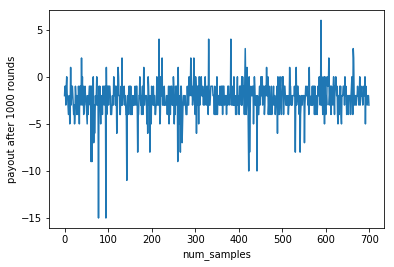

Average payout after 700 rounds is -2.2685714285714287


In [10]:
plt_result(average_payouts,agent)

In [11]:
print("Winning : {} percentage".format(win/5))
print("Losing : {} percentage".format(loss/5))
print("Draw : {} percentage".format(draw/5))

Winning : 34.6 percentage
Losing : 52.0 percentage
Draw : 13.4 percentage


### 2. Gamma 0.8

In [12]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)

agent = RLAgent(env,player1.player_name)
num_rounds = 700
num_samples = 700
num_episodes_to_train = 0.8* num_rounds
#epsilon=1.0, alpha=0.8, gamma=0.1
average_payouts = agent.train(epsilon=1.0, alpha=0.8, gamma=0.8,num_rounds = num_rounds,num_samples = num_samples,num_episodes_to_train=num_episodes_to_train)
#print(average_payouts)
print("Max of Payouts: ", max(average_payouts))


Initial state:  (21, 10, True)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  0
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 14
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (12, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 14
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (12, 10, True)
Next observation (12, 10, True)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (20, 10, False)
Initial state:  (11, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 22
Random Initial Bet: 7
Action:  1
Remaining bet 15
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 29
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
Initial state:  (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 29
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 38
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (19, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  25
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 14
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 14
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next

Round:  32
Action:  1
Remaining bet 2
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  32
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (27, 1, False)
Next observation (27, 1, False)
Initial state:  (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  33
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (17, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  34
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get ba

Remaining bet 30
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 30
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 39
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 39
Random Initial Bet: 2
Action:  1
Remaining bet 37
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
Action:  1
Remaining bet 37
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (21, 10, False)
Initial state:  (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 7
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (14, 6, False)
Next observation (14, 6, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
Remaining bet 0
State after 1st action: (11, 10, False)
Next observation (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
Remaining bet 0
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round

Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  57
player name: player1 money left: 84
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 74
State after 1st action: (12, 2, False)
Next observation (12, 2, False)
Initial state:  (17, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  58
player name: player1 money left: 74
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 70
State after 1st action: (17, 4, False)
Next observation (17, 4, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  59
player name: player1 money left: 70
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 80
State after 1st action: (20, 7, False)
Next obs

Remaining bet 19
State after 1st action: (14, 6, False)
Next observation (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (14, 6, False)
Next observation (14, 6, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 19
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 20
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (4, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 20
Random Initial Bet: 3
Action:  1
Remaining bet 17
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 20
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 26
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
Initial state:  (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 26
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 23
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 28
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (14, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: playe

Random Initial Bet: 7
Action:  1
Remaining bet 6
State after 1st action: (20, 2, True)
Next observation (20, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 20
State after 1st action: (20, 2, True)
Next observation (20, 2, True)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 20
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 11
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 21
State after 1st action: (20, 6, False)
Next observation (20, 6, 

Next observation (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  38
Action:  0
Draw match
Remaining bet 48
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  39
player name: player1 money left: 48
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 43
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (17, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  40
player name: player1 money left: 43
Random Initial Bet: 10
Action:  1
Remaining bet 33
State after 1st action: (19, 10, True)
Next observation (19, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 5
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (18, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 5
Random Initial Bet: 5
Action:  1
Remaining bet 0
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 10
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (12, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (22, 1, False)
Next observation (22, 1, False)
Initial state:  (8, 10, False)
%%%%%%%

State after 1st action: (15, 6, True)
Next observation (15, 6, True)
Initial state:  (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 8
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (9, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 6
Random Initial Bet: 4
Action:  1
Remaining bet 2
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
Action:  0
player winner
Remaining bet 10
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
Initial state:  (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  29
player name: player1 money left: 26
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 34
State after 1st action: (11, 5, False)
Next observation (11, 5, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 34
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (7, 10, False)
Next observation (7, 10, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 32
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 25
State after 1st action: (23, 7, False)
Next observation (23, 7, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  78
Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  79
player name: player1 money left: 15
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 20
State after 1st action: (14, 3, False)
Next observation (14, 3, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  80
player name: player1 money left: 20
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 22
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (12, 10, False)
%

Initial state:  (19, 7, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  142
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 17
State after 1st action: (19, 7, False)
Next observation (19, 7, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 17
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (7, 10, False)
Next observation (7, 10, False)
Initial state:  (10, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  55
Action:  1
Remaining bet 54
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  55
Action:  1
Remaining bet 54
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  55
Action:  0
player winner
Remaining bet 74
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  56
player name: player1 money left: 74
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 75
State after 1st action: (12, 5, False)
Next observation (12, 5, False)
Initial state:  (8, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Rou

Remaining bet 2
State after 1st action: (25, 1, False)
Next observation (25, 1, False)
Initial state:  (12, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (19, 7, False)
Next observation (19, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
player winner
Remaining bet 3
State after 1st action: (19, 7, False)
Next observation (19, 7, False)
Initial state:  (10, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
Remaining bet 1
State after 1st action: (21, 6, True)
Next observation (21, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (27, 9, False)
Initial state:  (11, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 5
Random Initial Bet: 1
Action:  1
Remaining bet 4
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  0
player winner
Remaining bet 6
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
Initial state:  (15, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 6
Random Initial Bet: 3
Action:  1
Remaining bet 3
State after 1st action: (19, 3, True)
Next observation (19, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  1
Remaining bet 3
State after 

Remaining bet 3
State after 1st action: (25, 3, False)
Next observation (25, 3, False)
Initial state:  (21, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 3
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 4
State after 1st action: (21, 8, True)
Next observation (21, 8, True)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 9, False)
Next observation (12, 9, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (21, 10, Tru

Round:  1
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Remaining bet 5
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
Remaining bet 5
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 15
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 15
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 17
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 14
State after 1st action: (18, 8, False)
Next observation (18, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  76
Action:  0
player winner
Remaining bet 20
State after 1st action: (18, 8, False)
Next observation (18, 8, False)
Initial state:  (9, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  77
player name: player1 money left: 20
Random Initial Bet: 5
Action:  1
Remaining bet 15
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  77
Action:  0
player winner
Remaining bet 25
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
Initial state:  (10, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  78
player na

Initial state:  (7, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 8
Random Initial Bet: 1
Action:  1
Remaining bet 7
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
Remaining bet 7
State after 1st action: (21, 3, False)
Next observation (21, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 9
State after 1st action: (21, 3, False)
Next observation (21, 3, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 9
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 13
State after 1st action: (12, 4,

Remaining bet 40
State after 1st action: (7, 6, False)
Next observation (7, 6, False)
Initial state:  (21, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  63
player name: player1 money left: 40
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 49
State after 1st action: (21, 5, True)
Next observation (21, 5, True)
Initial state:  (11, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  64
player name: player1 money left: 49
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 42
State after 1st action: (11, 6, False)
Next observation (11, 6, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  65
player name: player1 money left: 42
Random Initial Bet: 5
Action:  1
player loser, wont get back the mone

Remaining bet 23
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (21, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 23
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 24
State after 1st action: (21, 8, True)
Next observation (21, 8, True)
Initial state:  (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 24
Random Initial Bet: 7
Action:  1
Remaining bet 17
State after 1st action: (19, 10, True)
Next observation (19, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
Remaining bet 17
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
Draw match
Remaining bet 1
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (14, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (14, 4, False)
Next observation (14, 4, False)
Initial state:  (14, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
Remaining bet 0
State 

Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 14
Random Initial Bet: 7
Action:  0
Draw match
Remaining bet 14
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (10, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 14
Random Initial Bet: 1
Action:  1
Remaining bet 13
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  0
player winner
Remaining bet 15
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: playe

Remaining bet 25
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
Initial state:  (20, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  47
player name: player1 money left: 25
Random Initial Bet: 3
Action:  1
Remaining bet 22
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  47
Action:  0
Draw match
Remaining bet 25
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  48
player name: player1 money left: 25
Random Initial Bet: 2
Action:  1
Remaining bet 23
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (14, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 62
Random Initial Bet: 8
Action:  1
Remaining bet 54
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
Action:  1
player loser, wont get back the money, try next round
Remaining bet 54
State after 1st action: (26, 5, False)
Next observation (26, 5, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 54
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 59
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  189
player name: player1 money left: 84
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 88
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  190
player name: player1 money left: 88
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 95
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  191
player name: player1 money left: 95
Random Initial Bet: 3
Action:  1
Remaining bet 92
State after 1st action: (14, 3, False)
Next observation (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 7
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (23, 2, False)
Next observation (23, 2, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (20, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  285
-------

Action:  1
Remaining bet 17
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  1
Remaining bet 17
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 23
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (11, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 23
Random Initial Bet: 5
Action:  1
Remaining bet 18
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
Draw match
Remaining bet 23
State afte

Next observation (27, 10, False)
Initial state:  (21, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 31
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 40
State after 1st action: (21, 7, True)
Next observation (21, 7, True)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 40
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 35
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 35
Random Initial Bet: 1
Action:  1
Remaining bet 34
State after 1st action: (16, 10, False)
Next observation (16, 10, Fal

Next observation (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (14, 3, False)
Next observation (14, 3, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 3
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 5
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (18, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 5
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 7
State after 1st action: (18, 5, False)
Next observation (18, 5, False)
Initial state:  (5, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  35
player name: player1 money left: 61
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 63
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (6, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  36
player name: player1 money left: 63
Random Initial Bet: 1
Action:  1
Remaining bet 62
State after 1st action: (9, 3, False)
Next observation (9, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  36
Action:  1
Remaining bet 62
State after 1st action: (12, 3, False)
Next observation (12, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  36
Action:  1
player loser, wont get back the money, try next round
R

Next observation (13, 9, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  328
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (19, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player nam

Round:  3
player name: player1 money left: 12
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 14
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (12, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 14
Random Initial Bet: 5
Action:  1
Remaining bet 9
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 19
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 19
Random Initial Bet: 4
Action:  1
Remaining bet 15
State after 1st action: (14, 10, False)
Next observation (14, 10, 

Next observation (12, 5, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 3
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 5
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
Initial state:  (4, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 5
Random Initial Bet: 5
Action:  1
Remaining bet 0
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 9, False)
Next observation (23, 9, False)
Initial state:  (4, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (13, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  57
player name: player1 money left: 19
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (22, 2, False)
Next observation (22, 2, False)
Initial state:  (14, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  58
player name: player1 money left: 15
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 25
State after 1st action: (14, 4, False)
Next observation (14, 4, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  59
player name: player1 money left: 25
Random Initial Bet: 7
Action:  1
Remaining bet 18
State after 1st action: (18, 

Round:  11
player name: player1 money left: 8
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 12
State after 1st action: (12, 2, False)
Next observation (12, 2, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 12
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (14, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 5
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 7
State after 1st action: (14, 4, False)
Next observation (14, 4, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player 

Round:  12
Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 15
Random Initial Bet: 4
Action:  1
Remaining bet 11
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  1
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 11
Random Initial Bet: 5
Action:  1
Remaining bet 6
State after 1st action: (21, 10, Fals

Round:  3
Action:  0
player winner
Remaining bet 21
State after 1st action: (21, 9, False)
Next observation (21, 9, False)
Initial state:  (16, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 21
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (26, 6, False)
Next observation (26, 6, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 15
Random Initial Bet: 10
Action:  1
Remaining bet 5
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (24, 1

Initial state:  (17, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  79
player name: player1 money left: 78
Random Initial Bet: 5
Action:  0
Draw match
Remaining bet 78
State after 1st action: (17, 4, True)
Next observation (17, 4, True)
Initial state:  (5, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  80
player name: player1 money left: 78
Random Initial Bet: 6
Action:  1
Remaining bet 72
State after 1st action: (10, 8, False)
Next observation (10, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  80
Action:  1
Remaining bet 72
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  80
Action:  0
player winner
Remaining bet 84
State after 1st action: (20,

Initial state:  (13, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  412
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Remaining bet 1
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (27, 10, False)
Next observation (27, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 1
You can bet only 1, s

Remaining bet 12
State after 1st action: (14, 1, False)
Next observation (14, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
Action:  1
Remaining bet 12
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
Action:  0
player winner
Remaining bet 30
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 30
Random Initial Bet: 3
Action:  1
Remaining bet 27
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
Action:  0
Draw match
Remaining bet 30
State after 1st action

Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
Remaining bet 3
State after 1st action: (13, 8, False)
Next observation (13, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 5
State after 1st action: (13, 8, False)
Next observation (13, 8, False)
Initial state:  (19, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 5
Random Initial Bet: 1
Action:  1
Remaining bet 4
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Draw match
Remaining bet 5
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (21, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 5
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 10
State after 1st action: (21, 3, True)
Next observation (21, 3, True)
Initial state:  (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Remaining bet 3
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
Initial state:  (11, 6, False)

Action:  0
player winner
Remaining bet 60
State after 1st action: (14, 6, False)
Next observation (14, 6, False)
Initial state:  (15, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  40
player name: player1 money left: 60
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 61
State after 1st action: (15, 10, True)
Next observation (15, 10, True)
Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  41
player name: player1 money left: 61
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 51
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
Initial state:  (18, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  42
player name: player1 money left: 51
Random Initial Bet: 1
Action:  0
player

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
Remaining bet 0
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
Draw m

Remaining bet 13
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
Action:  0
player winner
Remaining bet 31
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
Initial state:  (11, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 31
Random Initial Bet: 5
Action:  1
Remaining bet 26
State after 1st action: (16, 3, False)
Next observation (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
Action:  1
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (26, 3, False)
Next observation (26, 3, False)
Initial state:  (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player winner
Remaining bet 50
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (19, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 50
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 40
State after 1st action: (22, 9, False)
Next observation (22, 9, False)
Initial state:  (18, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 40
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 42
State after 1st action: (18, 9, False)
Next observation (18, 9, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 42
Random Initial Bet: 9
Action:  0
player loser, w

Round:  4
Action:  1
Remaining bet 18
State after 1st action: (19, 1, True)
Next observation (19, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 30
State after 1st action: (19, 1, True)
Next observation (19, 1, True)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 30
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 39
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 39
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 37
State after 1st action: (24, 6, False)
Next observation (24, 6, False)
Initi

Action:  1
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (25, 3, False)
Next observation (25, 3, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 15
Random Initial Bet: 9
Action:  1
Remaining bet 6
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 6
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 9
State after 1st action: (13, 6, False)
Ne

Round:  26
player name: player1 money left: 20
Random Initial Bet: 4
Action:  1
Remaining bet 16
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
Action:  0
player winner
Remaining bet 24
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
Initial state:  (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 24
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 34
State after 1st action: (18, 10, True)
Next observation (18, 10, True)
Initial state:  (12, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 34
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 27
State aft

Next observation (19, 10, False)
Initial state:  (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 19
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 16
State after 1st action: (23, 5, False)
Next observation (23, 5, False)
Initial state:  (9, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 16
Random Initial Bet: 2
Action:  1
Remaining bet 14
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  0
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%

Initial state:  (19, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 3
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
Initial state:  (10, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 4
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money

Next observation (12, 9, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 23
Random Initial Bet: 9
Action:  0
Draw match
Remaining bet 23
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 23
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 17
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 17
Random Initial Bet: 2
Action:  1
Remaining bet 15
State after 1st action: (15, 10, False)
Next observation (15, 10, Fals

Round:  70
player name: player1 money left: 75
Random Initial Bet: 1
Action:  1
Remaining bet 74
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  70
Action:  0
player loser, wont get back the money, try next round
Remaining bet 74
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  71
player name: player1 money left: 74
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 69
State after 1st action: (13, 9, False)
Next observation (13, 9, False)
Initial state:  (13, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  72
player name: player1 money left: 69
Random Initial Bet: 7
Action: 

Round:  7
player name: player1 money left: 35
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 34
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (8, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 34
Random Initial Bet: 10
Action:  1
Remaining bet 24
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player winner
Remaining bet 44
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 44
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 48
State after 

Random Initial Bet: 7
Action:  1
Remaining bet 1
State after 1st action: (19, 2, False)
Next observation (19, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
Draw match
Remaining bet 8
State after 1st action: (19, 2, False)
Next observation (19, 2, False)
Initial state:  (19, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 8
Random Initial Bet: 8
Action:  1
Remaining bet 0
State after 1st action: (15, 6, False)
Next observation (15, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
Remaining bet 0
State after 1st action: (21, 6, False)
Next observation (21, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
player loser, wont get back the m

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (17, 4, False)
Next observation (17, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 3
State after 1st action: (17, 4, False)
Next observation (17, 4, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 3
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 6
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (11, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 6
Random Initial Bet: 5
A

Next observation (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player winner
Remaining bet 22
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 22
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 27
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 27
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 21
State after 1st action: (24, 1, False)
Next observation (24, 1, False)
Initial state:  (21, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (20, 8, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  62
player name: player1 money left: 9
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 15
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (10, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  63
player name: player1 money left: 15
Random Initial Bet: 2
Action:  1
Remaining bet 13
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  63
Action:  0
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  9
player name: player1 money left: 4
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (11, 6, False)
Next observation (11, 6, False)
Initial state:  (11, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 6
Random Initial Bet: 5
Action:  1
Remaining bet 1
State after 1st action: (16, 2, False)
Next observation (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (16, 2, False)
Next observation (16, 2, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player lo

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  61
Action:  1
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (27, 5, False)
Next observation (27, 5, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  62
player name: player1 money left: 12
Random Initial Bet: 8
Action:  0
Draw match
Remaining bet 12
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  63
player name: player1 money left: 12
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (16, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (12, 5, False)
Initial state:  (17, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 1, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  640
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (13, 1, False)
Next observation (13, 1, False)
Initial state:  (7, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: 

Next observation (16, 5, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
Remaining bet 0
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
player winner
Remaining bet 4
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
Initial state:  (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (19, 3, False)
Next observation (19, 3, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (7, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (7, 9, False)
Next observation (7, 9, False)
Initial state:  (13, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (13, 8, False)
Next observation (13, 8, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  674
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 1
Action:  1
Remaining bet 9
State after 1st action: (21, 8, False)
Next observation (21, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (20, 10, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  38
player name: player1 money left: 44
Random Initial Bet: 3
Action:  1
Remaining bet 41
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  38
Action:  0
Draw match
Remaining bet 44
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  39
player name: player1 money left: 44
Random Initial Bet: 2
Action:  1
Remaining bet 42
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  39
Action:  0
Draw match
Remain

Action:  0
player loser, wont get back the money, try next round
Remaining bet 29
State after 1st action: (12, 9, False)
Next observation (12, 9, False)
Initial state:  (18, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 29
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 38
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 38
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 37
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  32
player name: player1 money left: 37


In [13]:
win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1

Initial state:  (9, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Hit
State after 1st action: (12, 10, False)
next obs (12, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Hit
State after 1st action: (21, 10, False)
next obs (21, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
Stay
player winner
State after 1st action: (21, 10, False)
next obs (21, 10, False)
Initial state:  (10, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1

player loser, wont get back the money, try next round
State after 1st action: (15, 10, True)
next obs (15, 10, True)
Initial state:  (8, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (8, 7, False)
next obs (8, 7, False)
Initial state:  (14, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  1
Hit
State after 1st action: (18, 10, False)
next obs (18, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 9
Random Initial Bet: 1
Action:  0
Stay
Draw match
State after 1st action: (18, 10, False)
next obs (18, 10, False)
Initial state:  (9, 8, False)
-----------

Action:  0
Stay
Draw match
State after 1st action: (20, 6, False)
next obs (20, 6, False)
Initial state:  (17, 8, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (26, 8, False)
next obs (26, 8, False)
Initial state:  (19, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
Stay
Draw match
State after 1st action: (19, 10, False)
next obs (19, 10, False)
Initial state:  (20, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
Stay
Draw match
State after 1st action: (20, 10, False)
next obs (20, 10, False)
Initial state:  (17, 8

Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (9, 4, False)
next obs (9, 4, False)
Initial state:  (19, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
Stay
Draw match
State after 1st action: (19, 10, False)
next obs (19, 10, False)
Initial state:  (12, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
Stay
player winner
State after 1st action: (12, 6, False)
next obs (12, 6, False)
Initial state:  (19, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (19, 10, False)
ne

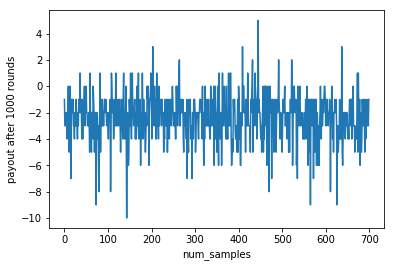

Average payout after 700 rounds is -2.375714285714286


In [14]:
plt_result(average_payouts,agent)

In [15]:
print("Winning : {} percentage".format(win/5))
print("Losing : {} percentage".format(loss/5))
print("Draw : {} percentage".format(draw/5))

Winning : 33.6 percentage
Losing : 53.6 percentage
Draw : 12.8 percentage


### 3 - Gamma 0.01

In [16]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)

agent = RLAgent(env,player1.player_name)
num_rounds = 700
num_samples = 700
num_episodes_to_train = 0.8* num_rounds
#epsilon=1.0, alpha=0.8, gamma=0.1
average_payouts = agent.train(epsilon=1.0, alpha=0.8, gamma=0.01,num_rounds = num_rounds,num_samples = num_samples,num_episodes_to_train=num_episodes_to_train)
#print(average_payouts)
print("Max of Payouts: ", max(average_payouts))


Initial state:  (20, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  0
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 18
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 18
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (10, 10, False)
Initial state:  (14, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 6
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 12
State after 1st action: (14, 8, False)
Next observation (14, 8, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 12
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (24, 3, False)
Next observation (24, 3, False)
Initial state:  (13, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 6
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: 

Next observation (25, 6, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 5, False)
Next observation (12, 5, False)
Initial state:  (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (20, 5, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  20
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: pl

Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (23, 8, False)
Next observation (23, 8, False)
Initial state:  (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 9
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (22, 6, False)
Next observation (22, 6, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (10, 7, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  37
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Remaining bet 3
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
Remaining bet 3
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try 

Remaining bet 40
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  42
player name: player1 money left: 40
Random Initial Bet: 10
Action:  1
Remaining bet 30
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  42
Action:  0
player winner
Remaining bet 50
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  43
player name: player1 money left: 50
Random Initial Bet: 10
Action:  1
Remaining bet 40
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  73
player name: player1 money left: 36
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  74
player name: player1 money left: 26
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 20
State after 1st action: (13, 4, False)
Next observation (13, 4, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  75
player name: player1 money left: 20
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 16
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
Remaining bet 0
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (16, 10, True)
Initial bet 10
-------------------------------------------------------------------------------------------

Next observation (18, 5, False)
Initial state:  (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 3
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action:

Remaining bet 35
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (21, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  39
player name: player1 money left: 35
Random Initial Bet: 2
Action:  1
Remaining bet 33
State after 1st action: (13, 5, False)
Next observation (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  39
Action:  1
Remaining bet 33
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  39
Action:  0
player winner
Remaining bet 37
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  40
player name: player1 money left: 

Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 12
Random Initial Bet: 2
Action:  0
Draw match
Remaining bet 12
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (9, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 12
Random Initial Bet: 9
Action:  1
Remaining bet 3
State after 1st action: (15, 3, False)
Next observation (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (15, 3, False)
Next observation (15, 3, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 48
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
Initial state:  (8, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  57
player name: player1 money left: 48
Random Initial Bet: 8
Action:  1
Remaining bet 40
State after 1st action: (11, 6, False)
Next observation (11, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  57
Action:  0
player loser, wont get back the money, try next round
Remaining bet 40
State after 1st action: (11, 6, False)
Next observation (11, 6, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  58
player name: player1 money left: 40
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 41
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
Initial state:  (21, 6, True)
%%%%

Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  82
player name: player1 money left: 41
Random Initial Bet: 4
Action:  1
Remaining bet 37
State after 1st action: (15, 7, False)
Next observation (15, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  82
Action:  1
Remaining bet 37
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  82
Action:  0
player winner
Remaining bet 45
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  83
player name: player1 money left: 45
Random Initial Bet: 2
Action:  1
Remaining bet 43
State after 1st action: (17, 10, Fa

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  43
Action:  0
Draw match
Remaining bet 5
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (16, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
player name: player1 money left: 5
Random Initial Bet: 4
Action:  1
Remaining bet 1
State after 1st action: (18, 2, True)
Next observation (18, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (18, 2, True)
Next observation (18, 2, True)
Initial state:  (16, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  45
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Rando

State after 1st action: (20, 6, False)
Next observation (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 16
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 16
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 26
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (13, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 26
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 21
State after 1st action: (13, 2, False)
Next observation (13, 2, False)
Initial state:  (20, 4, False)
%%%%%%%

Remaining bet 18
State after 1st action: (22, 1, False)
Next observation (22, 1, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 18
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 money left: 8
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (29, 6, False)
Next observation (29, 6, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
player name: player1 money left: 4
Random Initial Bet: 2
Ac

player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (15, 9, False)
Next observation (15, 9, False)
Initial state:  (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (10, 1, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  77
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (10, 1, False)
Next observation (10, 1, False)
Initial state:  (16, 5, True)
%%%%%%%%%%%%%%%%

Game number:  79
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 13
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 13
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 22
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 22
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 30
State after 1st action: (21, 10, True)
Nex

Remaining bet 6
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 6
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  0
player winner
Remaining bet 4
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (12, 4, False)
%%%

Next observation (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial state:  (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 6
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (19, 3, False)
Next observation (19, 3, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (21, 8, True)
Initial bet 10
----------------------------------------------------------------------------------

Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 11
Random Initial Bet: 4
Action:  1
Remaining bet 7
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 7
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (12, 9, False)
Next observation (12, 9, False)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (6, 10, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 16
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 22
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 22
Random Initial Bet: 10
Action:  0
Draw match
Remaining bet 22
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 22
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (23, 10, False)
Next observation

Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 16
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (9, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 16
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (9, 9, False)
Next observation (9, 9, False)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 7
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (17, 1, True)
%%%%%%%%%

Initial state:  (8, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 12
Random Initial Bet: 7
Action:  1
Remaining bet 5
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 19
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
Initial state:  (21, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 19
Random Initial Bet: 3
Action:  1
Remaining bet 16
State after 1st action: (15, 7, False)
Next observation (15, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player loser, wont get back the money, try next round
Remai

State after 1st action: (9, 4, False)
Next observation (9, 4, False)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Remaining bet 3
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 17
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (21, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 17
Random Initial Bet: 6
Action:  1
Remaining bet 11
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1

Remaining bet 16
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (17, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 16
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 20
State after 1st action: (17, 6, True)
Next observation (17, 6, True)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 20
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 16
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
Initial state:  (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 16
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 19
Stat

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 33
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (8, 7, False)
Next observation (8, 7, False)
Initial state:  (12, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 32
Random Initial Bet: 9
Action:  1
Remaining bet 23
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  1
Remaining bet 23
State after 1st action: (19, 3, False)
Next observation (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player winner
Remaining bet 41
State after 1st

Round:  24
player name: player1 money left: 30
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 37
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 money left: 37
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (13, 3, False)
Next observation (13, 3, False)
Initial state:  (12, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
player name: player1 money left: 32
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 29
State after 1st action: (12, 10, True)
Next observation (12, 10, True)
Initial state:  (5, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 2
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player winner
Remaining bet 4
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (15, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 4
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 5
State after 1st action: (15, 8, False)
Next observation (15, 8, False)
Initial state:  (19, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 5
Random Initial Bet: 4
Action:  0
Draw match
Remaining bet 5
State after 1st action: (19, 2, False)
Next observation (19, 2, False)
Initial state:  (9, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%

Round:  2
player name: player1 money left: 8
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (24, 1, False)
Next observation (24, 1, False)
Initial state:  (5, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 7
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (5, 4, False)
Next observation (5, 4, False)
Initial state:  (17, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 2, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  156
------------------------------------------

Remaining bet 57
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (17, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
player name: player1 money left: 57
Random Initial Bet: 2
Action:  1
Remaining bet 55
State after 1st action: (20, 7, True)
Next observation (20, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
Action:  1
Remaining bet 55
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
Action:  0
player loser, wont get back the money, try next round
Remaining bet 55
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (13, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:

Remaining bet 11
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (7, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 11
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (7, 9, False)
Next observation (7, 9, False)
Initial state:  (12, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 8
Random Initial Bet: 5
Action:  1
Remaining bet 3
State after 1st action: (19, 3, False)
Next observation (19, 3, False

Round:  3
player name: player1 money left: 22
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 32
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 32
Random Initial Bet: 9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (22, 6, False)
Next observation (22, 6, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 23
Random Initial Bet: 9
Action:  1
Remaining bet 14
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, tr

State after 1st action: (18, 5, False)
Next observation (18, 5, False)
Initial state:  (18, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 15
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (23, 9, False)
Next observation (23, 9, False)
Initial state:  (12, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 8
Random Initial Bet: 8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 4, True)
Next observation (12, 4, True)
Initial state:  (21, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 0
You have no money left ! Will go to next game !!
I

Next observation (17, 4, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 33
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (22, 4, False)
Next observation (22, 4, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 32
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 26
Random Initial Bet: 6
Action:  1
Remaining bet 20
State after 1st action: (20, 5,

Round:  58
player name: player1 money left: 33
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (17, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  59
player name: player1 money left: 23
Random Initial Bet: 1
Action:  1
Remaining bet 22
State after 1st action: (19, 10, True)
Next observation (19, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  59
Action:  1
Remaining bet 22
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  59
Action:  1
Remaining bet 22
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  2
player name: player1 money left: 15
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 24
State after 1st action: (15, 8, False)
Next observation (15, 8, False)
Initial state:  (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 24
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 33
State after 1st action: (16, 10, True)
Next observation (16, 10, True)
Initial state:  (13, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 33
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (13, 8, False)
Next observation (13, 8, False)
Initial state:  (11, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name

Remaining bet 1
State after 1st action: (17, 4, False)
Next observation (17, 4, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
Initial state:  (12, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 8, True)
Next observation (12, 8, True)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 0
You have no money left ! Will go to ne

player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (15, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (18, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  193
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 5
Action:  0
Draw match
Remaining bet 10
State after 1st action: (18, 8, False)
Next observation (18, 8, False)
Initial state:  (10, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  47
Action:  1
Remaining bet 51
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  47
Action:  0
player loser, wont get back the money, try next round
Remaining bet 51
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  48
player name: player1 money left: 51
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 44
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  49
player name: player1

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (28, 4, False)
Next observation (28, 4, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 23
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 25
State after 1st action: (14, 3, False)
Next observation (14, 3, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 25
Random Initial Bet: 1
Action:  0
Draw match
Remaining bet 25
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (4, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player winner
Remaining bet 16
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 16
Random Initial Bet: 7
Action:  1
Remaining bet 9
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player winner
Remaining bet 23
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 23
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initi

Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (17, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 6
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 5, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  224
----------------------------------------------------------------------------------

Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 money left: 3
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 4
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 7
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 7
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 2, False)
Next observation (12, 2, False)
Initial state:  (19, 

Round:  8
player name: player1 money left: 6
Random Initial Bet: 3
Action:  1
Remaining bet 3
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  1
Remaining bet 3
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player winner
Remaining bet 9
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 9
Random Initial Bet: 4
Action:  1
Remaining bet 5
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

State after 1st action: (22, 2, False)
Next observation (22, 2, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 5, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  245
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (23, 5, False)
Next observation (23, 5, False)
Initial state:  (17, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 17
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (28, 2, False)
Next observation (28, 2, False)
Initial state:  (21, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
Remaining bet 7
State after 1st action: (21, 2, False)
Next observation (21, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
Action:  0
player winner
Remaining bet 13
State after 1st action: (21, 2, False)
Next observation (21, 2, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  32
player name

Next observation (26, 7, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (18, 2, True)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  253
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Remaining bet 2
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 18
State after 1st action: (14, 2, False)
Next observation

State after 1st action: (24, 6, False)
Next observation (24, 6, False)
Initial state:  (7, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 5
Random Initial Bet: 3
Action:  1
Remaining bet 2
State after 1st action: (15, 3, False)
Next observation (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  1
Remaining bet 2
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (28, 3, False)
Next observation (28, 3, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: p

Next observation (24, 1, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
St

Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (8, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 5
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 9
State after 1st action: (8, 7, False)
Next observation (8, 7, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 9
Random Initial Bet: 5
Action:  1
Remaining bet 4
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 14
State after 1st action: (21, 5, False)
Next observation (21, 5, Fa

Action:  1
player loser, wont get back the money, try next round
Remaining bet 52
State after 1st action: (30, 2, False)
Next observation (30, 2, False)
Initial state:  (11, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 52
Random Initial Bet: 4
Action:  1
Remaining bet 48
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
Action:  0
Draw match
Remaining bet 52
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
Initial state:  (14, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 52
Random Initial Bet: 6
Action:  1
Remaining bet 46
State after 1st action: (16, 1, False)
Next observation (16, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 18
State after 1st action: (19, 5, False)
Next observation (19, 5, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 18
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 16
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (11, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 16
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (11, 4, False)
Next observation (11, 4, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 13
Random Initial Bet: 3
Ac

State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 8
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (16, 10, True)
Next observation (16, 10, True)
Initial state:  (16, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 6
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (16, 1, False)
Next observation (16, 1, False)
Initial state:  (14, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random In

player name: player1 money left: 30
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 35
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (21, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 35
Random Initial Bet: 1
Action:  1
Remaining bet 34
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 34
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (10, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 34
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next ro

Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 32
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 29
State after 1st action: (22, 6, False)
Next observation (22, 6, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 29
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 25
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (13, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  32
player name: player1 money left: 25
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 24
State 

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  91
player name: player1 money left: 32
Random Initial Bet: 8
Action:  1
Remaining bet 24
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  91
Action:  0
player winner
Remaining bet 40
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (16, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  92
player name: player1 money left: 40
Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 35
State after 1st action: (26, 4, False)
Next observation (26, 4, False)
Initial state:  (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  93
player na

player loser, wont get back the money, try next round
Remaining bet 18
State after 1st action: (23, 1, False)
Next observation (23, 1, False)
Initial state:  (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 18
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (15, 3, False)
Next observation (15, 3, False)
Initial state:  (15, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 9
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (15, 6, False)
Next observation (15, 6, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: 

Round:  3
Action:  0
player winner
Remaining bet 36
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 36
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 37
State after 1st action: (19, 3, False)
Next observation (19, 3, False)
Initial state:  (4, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 37
Random Initial Bet: 1
Action:  1
Remaining bet 36
State after 1st action: (14, 6, False)
Next observation (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
Remaining bet 36
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (20, 7, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 31
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 36
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 36
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 30
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (5, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 30
Random Initial Bet: 5
Action:  1
Remaining bet 25
State after 1st action: (15, 1, False)
Next observation (15, 1, False

Next observation (20, 10, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
Remaining bet 0
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (21, 8, True)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  414
---------

player name: player1 money left: 16
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (16, 10, True)
Next observation (16, 10, True)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 9
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (16, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (18, 7, True)
Next observation (18, 7, True)
Initial state:  (7, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (13, 7, False)
Next observation (13, 7, False)
Initial state:  (9, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 

player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (20, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 7
Random Initial Bet: 7
Action:  1
Remaining bet 0
State after 1st action: (13, 6, False)
Next observation (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  1
Remaining bet 0
State after 1st action: (18, 6, False)
Next observation (18, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (28, 6, False)
Next observation (28, 6, False)
Initial state:  (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 20
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 22
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (18, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 22
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 25
State after 1st action: (18, 7, True)
Next observation (18, 7, True)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 25
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (22, 6, False)
Next observation (22, 6, False)
Initial st

Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (16, 6, False)
Next observation (16, 6, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 4
State after 1st action: (12, 8, False)
Next observation (12, 8, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
Remaining bet 3
State after 1st action: (9, 10, False)
Next observation (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
Remaining bet 3
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%

Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 16
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 26
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 26
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (12, 8, False)
Next observation (12, 8, False)
Initial state:  (18, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 19
Random Initial Bet: 6
Action:  0
Draw match
Remaining bet 19
State after 1st action: (18, 8, False)
Next observation (18, 8, False)
Initial state:  (19,

Remaining bet 2
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (13, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (13, 2, False)
Next observation (13, 2, False)
Initial state:  (18, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (15, 6,

Action:  1
Remaining bet 45
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  121
Action:  0
player winner
Remaining bet 53
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (14, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  122
player name: player1 money left: 53
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 47
State after 1st action: (14, 10, True)
Next observation (14, 10, True)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  123
player name: player1 money left: 47
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 43
State after 1st action: (15, 9, Fals

Initial state:  (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 21
Random Initial Bet: 9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (24, 2, False)
Next observation (24, 2, False)
Initial state:  (14, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 12
Random Initial Bet: 2
Action:  1
Remaining bet 10
State after 1st action: (13, 1, False)
Next observation (13, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  1
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (23, 1, False)
Next observation (23, 1, False)
Initial state:  (9, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  35
Action:  1
player loser, wont get back the money, try next round
Remaining bet 34
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  36
player name: player1 money left: 34
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 38
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  37
player name: player1 money left: 38
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 30
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  38
player name: player1

Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (26, 8, False)
Next observation (26, 8, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (22, 5, False)
Next observation (22, 5, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 3
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 6
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (15, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 6
Random I

Next observation (21, 10, True)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 17
Random Initial Bet: 7
Action:  1
Remaining bet 10
State after 1st action: (11, 10, False)
Next observation (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  1
Remaining bet 10
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  0
player winner
Remaining bet 24
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (21, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 24
Random Initial Bet: 9
Action:  1
Remaining bet 1

Round:  71
player name: player1 money left: 54
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 64
State after 1st action: (21, 9, True)
Next observation (21, 9, True)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  72
player name: player1 money left: 64
Random Initial Bet: 5
Action:  1
Remaining bet 59
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  72
Action:  0
Draw match
Remaining bet 64
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (5, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  73
player name: player1 money left: 64
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 65
State after 1st action: (5, 5, False)
Next observa

player name: player1 money left: 9
Random Initial Bet: 3
Action:  1
Remaining bet 6
State after 1st action: (19, 10, True)
Next observation (19, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
Remaining bet 6
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (15, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 6
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (23, 4, False)
Next observation (23, 4, False)
Initial state:  (1

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (15, 4, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  592
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (24, 4, False)
Next observation (24, 4, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 5
Random Initial Bet: 1
Action:  1
Remain

Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (17, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (17, 9, False)
Next observation (17, 9, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (20, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  606
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%

Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (8, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
Remaining bet 0
State after 1st action: (13, 2, False)
Next observation (13, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (13, 2, False)
Next observation (13, 2, False)
Initial state:  (11, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (14, 10, False)
Initial bet 10
--------------

player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (12, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 9
Random Initial Bet: 1
Action:  1
Remaining bet 8
State after 1st action: (14, 1, False)
Next observation (14, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
Remaining bet 8
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 10
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 23
Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 18
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (21, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 18
Random Initial Bet: 3
Action:  1
Remaining bet 15
State after 1st action: (16, 7, False)
Next observation (16, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
Remaining bet 15
State after 1st action: (21, 7, False)
Next observation (21, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner


Action:  1
player loser, wont get back the money, try next round
Remaining bet 34
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 34
Random Initial Bet: 6
Action:  1
Remaining bet 28
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  0
player winner
Remaining bet 40
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (9, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 40
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 45
State after 1st action: (9, 4, False)
Next observation (9, 4, False)
Init

Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (24, 8, False)
Next observation (24, 8, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 3
Random Initial Bet: 3
Action:  1
Remaining bet 0
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player winner
Remaining bet 6
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (13, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 6
Random Initial Bet: 1
Action:  1
Remaining bet 5
State after 1st action: (14, 5, True)
Next observation (14, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (9, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 16
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (9, 9, False)
Next observation (9, 9, False)
Initial state:  (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 7
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
Initial state:  (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 6
Random Initial Bet: 5
Action:  0
Draw match
Remaining bet 6
State after 1st action: (20, 4, False)
Next observation (20,

In [17]:
win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1

Initial state:  (12, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
Hit
State after 1st action: (15, 6, False)
next obs (15, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (15, 6, False)
next obs (15, 6, False)
Initial state:  (7, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Hit
State after 1st action: (10, 7, False)
next obs (10, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 5
Random Initial Bet: 1
Action:  1
Hit
S

Random Initial Bet: 6
Action:  0
Stay
player winner
State after 1st action: (9, 4, False)
next obs (9, 4, False)
Initial state:  (15, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (15, 3, False)
next obs (15, 3, False)
Initial state:  (12, 1, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (22, 1, False)
next obs (22, 1, False)
Initial state:  (14, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
Hit
State after 1st action: (21, 7, False

next obs (16, 1, False)
Initial state:  (17, 8, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (17, 8, False)
next obs (17, 8, False)
Initial state:  (20, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
Stay
Draw match
State after 1st action: (20, 10, False)
next obs (20, 10, False)
Initial state:  (13, 5, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (23, 5, False)
next obs (23, 5, False)
Initial state:  (7, 9, False)
------------------

next obs (15, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 0
You have no money left! Will go to next game !!
Initial state:  (13, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
Hit
State after 1st action: (20, 10, False)
next obs (20, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
Stay
player winner
State after 1st action: (20, 10, False)
next obs (20, 10, False)
Initial state:  (18, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Action:  1
Hit
player loser, wont get back the money, try next round
State aft

player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
Stay
player winner
State after 1st action: (16, 5, False)
next obs (16, 5, False)
Initial state:  (18, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (26, 9, False)
next obs (26, 9, False)
Initial state:  (8, 1, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
Hit
State after 1st action: (13, 1, False)
next obs (13, 1, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 4
Random Initial Bet: 3
Action:  1
Hit
State after 1st action: (15, 1, False)
next obs (15, 1, False)
------------------------

Stay
player loser, wont get back the money, try next round
State after 1st action: (15, 7, False)
next obs (15, 7, False)
Initial state:  (7, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (7, 3, False)
next obs (7, 3, False)
Initial state:  (14, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Hit
State after 1st action: (17, 10, False)
next obs (17, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 3
Random Initial Bet: 3
Action:  1
Hit
State after 1st action: (18, 10, False)
next obs (18, 10, False)
-------------------------------------------------

In [18]:
print("Winning : {} percentage".format(win/5))
print("Losing : {} percentage".format(loss/5))
print("Draw : {} percentage".format(draw/5))

Winning : 31.2 percentage
Losing : 56.6 percentage
Draw : 12.2 percentage


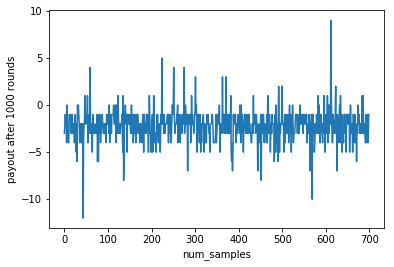

Average payout after 700 rounds is -2.172857142857143


In [19]:
plt_result(average_payouts,agent)

**Gamma (Discount factor): ** It corresponds to future rewards. If the discount factor is 0 the agent is short sighted and considers only current rewards where as  a factor of 1 will make it strive for a long-term high reward.

In the above plots we can see that a low gamma value of 0.01, 0.1 makes the agent to just avoid the next wall without thinking about the future reward where as a high gamma value of 0.9 will make the agent to avoid the wall and also move towards the goal.

### 1. Alpha 0.1

In [20]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)

agent = RLAgent(env,player1.player_name)
num_rounds = 700
num_samples = 700
num_episodes_to_train = 0.8* num_rounds
#epsilon=1.0, alpha=0.8, gamma=0.1
average_payouts = agent.train(epsilon=0.1, alpha=0.1, gamma=0.99,num_rounds = num_rounds,num_samples = num_samples,num_episodes_to_train=num_episodes_to_train)
#print(average_payouts)
print("Max of Payouts: ", max(average_payouts))


Initial state:  (20, 3, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  0
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 18
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (6, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 18
Random Initial Bet: 9
Action:  1
Remaining bet 9
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
player loser, wont get back the mon

State after 1st action: (15, 3, False)
Next observation (15, 3, False)
Initial state:  (18, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 15
Random Initial Bet: 10
Action:  1
Remaining bet 5
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (9, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 5
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 6
State after 1st action: (9, 5, False)
Next observation (9, 5, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 22
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 22
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 23
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 23
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 25
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 25
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 23
Sta

Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Remaining bet 2
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (8, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (8, 6, False)
Next observation (8, 6, False)
Initial state:  (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Ran

State after 1st action: (13, 3, False)
Next observation (13, 3, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 34
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
Initial state:  (14, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 32
Random Initial Bet: 2
Action:  1
Remaining bet 30
State after 1st action: (12, 8, False)
Next observation (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  0
player loser, wont get back the money, try next round
Remaining bet 30
State after 1st action: (12, 8, False)
Next observation (12, 8, False)
Initial 

Next observation (27, 6, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 5
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 10
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (9, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Remaining bet 1
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
Action:  0
player winner
Remaining bet 19
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (20, 10, False)
Initial state:  (10, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  49
player name: player1 money left: 26
Random Initial Bet: 6
Action:  1
Remaining bet 20
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  49
Action:  0
player winner
Remaining bet 32
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  50
player name: player1 money left: 32
Random Initial Bet: 7
Action:  1
Remaining bet 25
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  50
Action:  0
player winner
Remai

Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 11
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 18
State after 1st action: (9, 10, False)
Next observation (9, 10, False)
Initial state:  (4, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 18
Random Initial Bet: 9
Action:  1
Remaining bet 9
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st 

Remaining bet 16
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 16
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (22, 5, False)
Next observation (22, 5, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 10
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 15
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 15
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 16
S

Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Remaining bet 0
State after 1st action: (16, 3, False)
Next observation (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (26, 3, False)
Next observation (26, 3, False)
Initial state:  (14, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  59
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 3
State after 1st action: (17, 10, True)
Next observation (17, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
Action:  0
Draw match
Remaining bet 11
State after 1st action: (17, 10, True)
Next observation (17, 10, True)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 11
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 12
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
Initial state:  (9, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 12
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (9, 9, False)
Next observation (9, 9, False)
Initial state:  (12, 2, Fal

Action:  0
Draw match
Remaining bet 10
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 18
State after 1st action: (9, 10, False)
Next observation (9, 10, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 18
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 27
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (9, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 27
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 37
State after 1st act

Remaining bet 27
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 27
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 28
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 28
Random Initial Bet: 2
Action:  1
Remaining bet 26
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  0
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (14, 5, Fals

player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (20, 5, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  81
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
Draw match
Remaining bet 10
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (21, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 18
State after 1st action: (21, 8, True)
Next observation (21, 8, True)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 30
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  56
Action:  0
player winner
Remaining bet 46
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (14, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  57
player name: player1 money left: 46
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 40
State after 1st action: (14, 8, True)
Next observation (14, 8, True)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  58
player name: player1 money left: 40
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (24, 3, False)
Nex

Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  1
Remaining bet 0
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (21, 9, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (14, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  88
--------------------------------------------------------------------------------------------------

State after 1st action: (15, 3, False)
Next observation (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
Remaining bet 2
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
Draw match
Remaining bet 10
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
Initial state:  (14, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (14, 8, False)
Next observation (14, 8, False)
Initial state:  (7, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player

Round:  11
Action:  1
player loser, wont get back the money, try next round
Remaining bet 24
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 24
Random Initial Bet: 6
Action:  1
Remaining bet 18
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
Action:  0
player winner
Remaining bet 30
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (10, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 30
Random Initial Bet: 10
Action:  1
Remaining bet 20
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%

Round:  4
Action:  0
Draw match
Remaining bet 3
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
Remaining bet 2
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 4
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6


Next observation (21, 10, True)
Initial state:  (10, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 4
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
Initial state:  (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (22, 9, False)
Next observation (22, 9, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 11
State after 1st action: (5, 2, False)
Next observation (5, 2, False)
Initial state:  (10, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 11
Random Initial Bet: 6
Action:  1
Remaining bet 5
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 17
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (7, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 17
Random Initial Bet: 4
Action:  1
Remaining bet 13
State after 1st action: (18, 5, True)
Next observation (18, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 8
State after 1st action: (21, 5, True)
Next observation (21, 5, True)
Initial state:  (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 8
Random Initial Bet: 7
Action:  1
Remaining bet 1
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%

Initial state:  (20, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 15
Random Initial Bet: 5
Action:  1
Remaining bet 10
State after 1st action: (21, 1, True)
Next observation (21, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
Draw match
Remaining bet 15
State after 1st action: (21, 1, True)
Next observation (21, 1, True)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 15
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (13, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 9
State after 1st action: (9, 2, False)
Next observation (9, 2, False)
Initial state:  (16, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 9
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (16, 7, True)
Next observation (16, 7, True)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 8
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 15
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 15
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try n

Round:  65
player name: player1 money left: 71
Random Initial Bet: 3
Action:  1
Remaining bet 68
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  65
Action:  0
player loser, wont get back the money, try next round
Remaining bet 68
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  66
player name: player1 money left: 68
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 65
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
Initial state:  (17, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  67
player name: player1 money left: 65
Random Initial Bet: 2
Action:  0
p

Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (8, 1, False)
Next observation (8, 1, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 15
Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial state:  (9, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  

Game number:  168
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (14, 10, True)
Next observation (14, 10, True)
Initial state:  (12, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 9
Random Initial Bet: 1
Action:  1
Remaining bet 8
State after 1st action: (14, 8, True)
Next observation (14, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (14, 8, True)
Next observation (14, 8, True)
Initi

Next observation (11, 2, False)
Initial state:  (10, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  35
player name: player1 money left: 59
Random Initial Bet: 4
Action:  1
Remaining bet 55
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  35
Action:  0
player winner
Remaining bet 63
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  36
player name: player1 money left: 63
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 53
State after 1st action: (13, 4, False)
Next observation (13, 4, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 3
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
Action:  0
player winner
Remaining bet 15
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 15
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 23
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (18, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 23
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 18
State after 1st action: (18, 8, False)
Next observation (18, 8, False)
In

Action:  1
Remaining bet 2
State after 1st action: (19, 6, True)
Next observation (19, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  85
Action:  0
player winner
Remaining bet 16
State after 1st action: (19, 6, True)
Next observation (19, 6, True)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  86
player name: player1 money left: 16
Random Initial Bet: 3
Action:  1
Remaining bet 13
State after 1st action: (16, 7, False)
Next observation (16, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  86
Action:  0
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (16, 7, False)
Next observation (16, 7, False)
Initial state:  (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 13
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 13
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 19
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 19
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (14, 6, False)
Next observation (14, 6, False)
Initial state:  (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 12
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 20
Stat

Action:  1
Remaining bet 3
State after 1st action: (11, 3, False)
Next observation (11, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (11, 3, False)
Next observation (11, 3, False)
Initial state:  (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (26, 9, False)
Next observation (26, 9, False)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State 

You have no money left ! Will go to next game !!
Initial state:  (20, 5, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  195
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 18
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (7, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 18
Random Initial Bet: 6
Action:  1
Remaining bet 12
State after 1st action: (18, 9, True)
Next observation (18, 9, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:

player name: player1 money left: 24
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (16, 7, False)
Next observation (16, 7, False)
Initial state:  (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 19
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 23
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (11, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
player name: player1 money left: 23
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 17
State after 1st action: (11, 5, False)
Next observation (11, 5, False)
Initial state:  (21, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 16
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
Initial state:  (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 6
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (22, 9, False)
Next observation (22, 9, False)
Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (21, 6, True)
Initial bet 10
-------------------------

Action:  0
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (4, 10, False)
Next observation (4, 10, False)
Initial state:  (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  54
player name: player1 money left: 11
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 17
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  55
player name: player1 money left: 17
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  56
player name: player1 money left: 7


Round:  3
player name: player1 money left: 4
Random Initial Bet: 3
Action:  1
Remaining bet 1
State after 1st action: (16, 9, False)
Next observation (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (26, 9, False)
Next observation (26, 9, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
Y

player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (24, 4, False)
Next observation (24, 4, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 4
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 5
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 5
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 8
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (16, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 8
Random Initial Bet: 1
Action:  0
player loser, wont get b

Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (22, 5, False)
Next observation (22, 5, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 5
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (22, 3, False)
Next observation (22, 3, False)
Initial state:  (21, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 4
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (21, 6, True)
Next observation (21, 6, True)
Initial state:  (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 mone

Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 5
Random Initial Bet: 2
Action:  1
Remaining bet 3
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
Draw match
Remaining bet 5
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (18, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 5
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (28, 9, False)
Next observation (28, 9, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (5, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (5, 10, False)
Next observation (5, 10, False)
Initial state:  (16, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (21, 5, True)
Initial bet 10
--------------------------------------------

Action:  0
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 19
Random Initial Bet: 10
Action:  1
Remaining bet 9
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (23, 5, False)
Next observation (23, 5, False)
Initial state:  (19, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 9
Random Initial Bet: 7
Action:  1
Remaining bet 2
State after 1st action: (13, 5, False)
Next observation (1

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 5
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 6
State after 1st action: (11, 3, False)
Next observation (11, 3, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 6
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 9
State after 1st action: (9, 10, False)
Next observation (9, 10, False)
Initial state:  (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 9
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (24, 1, False)
Next observation (24, 1, False)
Initial state:  (9, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  4
Action:  0
player winner
Remaining bet 5
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 5
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 8
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (11, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 8
Random Initial Bet: 6
Action:  1
Remaining bet 2
State after 1st action: (13, 9, False)
Next observation (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  1
Remaining bet 2
State after 1st action: (19, 9, False)
Next observation (19, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player winner
Remaining bet 30
State after 1st action: (11, 9, False)
Next observation (11, 9, False)
Initial state:  (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 30
Random Initial Bet: 9
Action:  0
Draw match
Remaining bet 30
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (14, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 30
Random Initial Bet: 10
Action:  1
Remaining bet 20
State after 1st action: (19, 4, True)
Next observation (19, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
Remaining bet 20
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (14, 7, False)
Initial state:  (12, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 31
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 28
State after 1st action: (12, 3, False)
Next observation (12, 3, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 28
Random Initial Bet: 7
Action:  1
Remaining bet 21
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 21
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%

Round:  7
player name: player1 money left: 13
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (13, 4, False)
Next observation (13, 4, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 7
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 7
Random Initial Bet: 6
Action:  0
Draw match
Remaining bet 7
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: p

Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (25, 6, False)
Next observation (25, 6, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
Draw match
Remaining bet 4
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (11, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (11, 5, False)
Next observation (11, 5, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have

player winner
Remaining bet 27
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 27
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 29
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (8, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 29
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 30
State after 1st action: (8, 7, False)
Next observation (8, 7, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 30
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remain

Action:  1
Remaining bet 7
State after 1st action: (10, 8, False)
Next observation (10, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (10, 8, False)
Next observation (10, 8, False)
Initial state:  (7, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 7
Random Initial Bet: 4
Action:  1
Remaining bet 3
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  0
player winner
Remaining bet 11
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (16, 7, False)
Next observation (16, 7, False)
Initial state:  (6, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (6, 7, False)
Next observation (6, 7, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (17, 6, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  306
--------------------------------------------------------------------

Round:  13
Action:  0
Draw match
Remaining bet 30
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
Initial state:  (7, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 30
Random Initial Bet: 8
Action:  1
Remaining bet 22
State after 1st action: (11, 7, False)
Next observation (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  1
Remaining bet 22
State after 1st action: (21, 7, False)
Next observation (21, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  0
Draw match
Remaining bet 30
State after 1st action: (21, 7, False)
Next observation (21, 7, False)
Initial state:  (17, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
playe

Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
Initial state:  (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  310
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random 

Initial state:  (11, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 10
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (11, 9, False)
Next observation (11, 9, False)
Initial state:  (10, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (13, 9, False)
Next observation (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
Action:  1
Remaining bet 0
State after 1st action: (17, 9, False)
Next observation (17, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 6
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 6
Random Initial Bet: 2
Action:  1
Remaining bet 4
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 8
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
Initial state:  (13, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 8
Random Initial Bet: 6
Action:  1
Remaining bet 2
State after 1st action: (16, 1,

Next observation (15, 10, False)
Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 5
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (12, 2, False)
Next observation (12, 2, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 3
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 3
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 6
State after 1st action: (20, 5, False)
Next observation (20, 5

Next observation (27, 2, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
Action:  0
player winner
Remaining bet 3
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (18, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
Action:  0
player winner
Remaini

player loser, wont get back the money, try next round
Remaining bet 18
State after 1st action: (22, 3, False)
Next observation (22, 3, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 18
Random Initial Bet: 1
Action:  0
Draw match
Remaining bet 18
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 18
Random Initial Bet: 7
Action:  1
Remaining bet 11
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 25
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (19, 9

Remaining bet 2
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (17, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  352
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 17
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 17
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (23, 9, False)
Next observation (23, 9, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 13
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 23
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%

State after 1st action: (19, 2, False)
Next observation (19, 2, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 29
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 23
Random Initial Bet: 6
Action:  1
Remaining bet 17
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player winner
Remaining bet 29
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
Initial state:  (7, 7, False)
%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 12
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (26, 5, False)
Next observation (26, 5, False)
Initial state:  (9, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 6
Random Initial Bet: 2
Action:  1
Remaining bet 4
State after 1st action: (11, 7, False)
Next observation (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
Remaining bet 4
State after 1st action: (15, 7, False)
Next observation (15, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player loser, wont get back the money, try next roun

State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 16
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 16
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (26, 3, False)
Next observation (26, 3, False)
Initial state:  (12, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 10
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (12, 2, False)
Next observation (12, 2, Fal

State after 1st action: (19, 2, False)
Next observation (19, 2, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (22, 5, False)
Next observation (22, 5, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (7, 5, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  386
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 48
State after 1st action: (17, 9, False)
Next observation (17, 9, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 48
Random Initial Bet: 4
Action:  1
Remaining bet 44
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
Action:  0
Draw match
Remaining bet 48
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 48
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 40
State after 1st action: (27, 3, False)
Next observation (27, 3, False)
Initial state:  (5, 4, False)
%%

Action:  0
player winner
Remaining bet 35
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (14, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 35
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 25
State after 1st action: (14, 10, True)
Next observation (14, 10, True)
Initial state:  (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 25
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 17
State after 1st action: (23, 6, False)
Next observation (23, 6, False)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 17
Ra

player name: player1 money left: 10
Random Initial Bet: 9
Action:  0
Draw match
Remaining bet 10
State after 1st action: (20, 7, True)
Next observation (20, 7, True)
Initial state:  (9, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 14
State after 1st action: (9, 6, False)
Next observation (9, 6, False)
Initial state:  (12, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 14
Random Initial Bet: 5
Action:  1
Remaining bet 9
State after 1st action: (16, 10, True)
Next observation (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
Remaining bet 9
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
%%%%%%%%%%%%%%%%%

Random Initial Bet: 3
Action:  1
Remaining bet 3
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 9
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 9
Random Initial Bet: 8
Action:  1
Remaining bet 1
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 17
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (15, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (14, 8, True)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  453
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name:

Next observation (20, 10, False)
Initial state:  (11, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 8
Random Initial Bet: 7
Action:  1
Remaining bet 1
State after 1st action: (21, 6, False)
Next observation (21, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
Action:  0
player winner
Remaining bet 15
State after 1st action: (21, 6, False)
Next observation (21, 6, False)
Initial state:  (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 15
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 22
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

State after 1st action: (16, 5, False)
Next observation (16, 5, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 3
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (8, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  481
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  13
player name: player1 money left: 29
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 23
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (25, 3, False)
Next observation (25, 3, False)
Initial state:  (7, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 15
Random Initial Bet: 4
Action:  1
Remaining bet 11
State after 1st action: (18, 3, True)
Next observation (18, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
Rema

player name: player1 money left: 7
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 10
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (10, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Remaining bet 3
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (12, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remai

Next observation (21, 9, False)
Initial state:  (16, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 5
Random Initial Bet: 3
Action:  1
Remaining bet 2
State after 1st action: (20, 7, True)
Next observation (20, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  1
Remaining bet 2
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 1
Act

Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 16
Random Initial Bet: 3
Action:  1
Remaining bet 13
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
Action:  1
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 13
Random Initial Bet: 9
Action:  1
Remaining bet 4
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
Action:  1
playe

Action:  1
Remaining bet 5
State after 1st action: (17, 5, False)
Next observation (17, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (22, 5, False)
Next observation (22, 5, False)
Initial state:  (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 5
Random Initial Bet: 4
Action:  1
Remaining bet 1
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player winner
Remaining bet 9
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 23
Random Initial Bet: 3
Action:  1
Remaining bet 20
State after 1st action: (15, 7, False)
Next observation (15, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  0
player winner
Remaining bet 26
State after 1st action: (15, 7, False)
Next observation (15, 7, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 26
Random Initial Bet: 2
Action:  1
Remaining bet 24
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
Action:  1
player loser, wont get back the money, try next round
Remaining bet 24
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%

Next observation (20, 3, False)
Initial state:  (9, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 4
Random Initial Bet: 3
Action:  1
Remaining bet 1
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
Initial state:  (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 9
Action:  0
player winner
Remaining bet 19
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (16, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 19
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (16, 8, False)
Next observation (16, 8, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 9
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 17
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 17
Random Initial Bet: 

player name: player1 money left: 24
Random Initial Bet: 9
Action:  1
Remaining bet 15
State after 1st action: (16, 10, True)
Next observation (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  1
Remaining bet 15
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  1
Remaining bet 15
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 33
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (10, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 33
Random Initial

----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 2
Action:  1
Remaining bet 8
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 12
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (19, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 12
Random Initial Bet: 3
Action:  1
Remaining bet 9
State after 1st action: (13, 2, False)
Next observation (13, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:

Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (15, 9, False)
Next observation (15, 9, False)
Initial state:  (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 8
Random Initial Bet: 5
Action:  1
Remaining bet 3
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (13, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
Stat

Initial state:  (6, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (6, 10, False)
Next observation (6, 10, False)
Initial state:  (9, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (18, 4, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  630
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player

Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (24, 1, False)
Next observation (24, 1, False)
Initial state:  (11, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 8
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (11, 4, False)
Next observation (11, 4, False)
Initial state:  (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
Action:  0
Draw match
Remaining bet 2
State after 1st action:

Round:  18
player name: player1 money left: 24
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 32
State after 1st action: (18, 5, False)
Next observation (18, 5, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 32
Random Initial Bet: 10
Action:  1
Remaining bet 22
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
Action:  1
Remaining bet 22
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
Action:  1
player loser, wont get back the money, try next round
Remaining bet 22
State after 1st action: (26, 10, False)
Next observation (26, 10, False)
Initial state:  (10, 10, False)
%%

You have no money left ! Will go to next game !!
Initial state:  (12, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  684
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (21, 10, True)
Initial bet 10
---------------------------------------------------------------------------------------

Action:  1
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (28, 2, False)
Next observation (28, 2, False)
Initial state:  (6, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 32
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 25
State after 1st action: (6, 7, False)
Next observation (6, 7, False)
Initial state:  (21, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 25
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 31
State after 1st action: (21, 6, True)
Next observation (21, 6, True)
Initial state:  (9, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 money left: 31
Random 

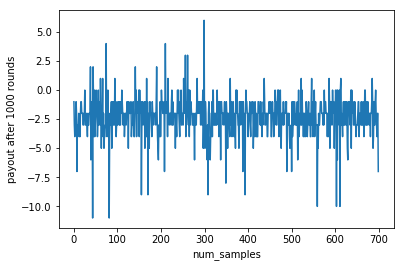

Average payout after 700 rounds is -2.2928571428571427


In [21]:
plt_result(average_payouts,agent)

In [22]:
win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1

Initial state:  (10, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Hit
State after 1st action: (19, 9, False)
next obs (19, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (24, 9, False)
next obs (24, 9, False)
Initial state:  (12, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
Stay
player winner
State after 1st action: (12, 10, False)
next obs (12, 10, False)
Initial state:  (20, 2, False)
----------------------------------------------------------------------------------------------------
player name: player1 mon

Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (27, 9, False)
next obs (27, 9, False)
Initial state:  (12, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (12, 4, False)
next obs (12, 4, False)
Initial state:  (13, 5, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  0
Stay
player winner
State after 1st action: (13, 5, False)
next obs (13, 5, False)
Initial state:  (12, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  0
Stay
player loser, wont get back the money, try next round


Random Initial Bet: 8
Action:  1
Hit
State after 1st action: (15, 8, False)
next obs (15, 8, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (22, 8, False)
next obs (22, 8, False)
Initial state:  (16, 7, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (16, 7, True)
next obs (16, 7, True)
Initial state:  (14, 1, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (14, 1

In [23]:
print("Winning : {} percentage".format(win/5))
print("Losing : {} percentage".format(loss/5))
print("Draw : {} percentage".format(draw/5))

Winning : 35.4 percentage
Losing : 53.8 percentage
Draw : 10.8 percentage


### 2. Alpha 0.8

In [24]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)

agent = RLAgent(env,player1.player_name)
num_rounds = 500
num_samples = 500
num_episodes_to_train = 0.8* num_rounds
#epsilon=1.0, alpha=0.8, gamma=0.1
average_payouts = agent.train(epsilon=0.1, alpha=0.8, gamma=0.99,num_rounds = num_rounds,num_samples = num_samples,num_episodes_to_train=num_episodes_to_train)
#print(average_payouts)
print("Max of Payouts: ", max(average_payouts))

Initial state:  (20, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  0
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  1
--------------------

Action:  0
player winner
Remaining bet 40
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 40
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 39
State after 1st action: (12, 9, False)
Next observation (12, 9, False)
Initial state:  (14, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 39
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 36
State after 1st action: (14, 8, False)
Next observation (14, 8, False)
Initial state:  (17, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 36


State after 1st action: (20, 4, False)
Next observation (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  68
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (30, 4, False)
Next observation (30, 4, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  69
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (7, 10, False)
Next observation (7, 10, False)
Initial state:  (21, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  70
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (21, 4, Tr

Action:  0
player winner
Remaining bet 27
State after 1st action: (6, 10, False)
Next observation (6, 10, False)
Initial state:  (10, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 27
Random Initial Bet: 7
Action:  1
Remaining bet 20
State after 1st action: (14, 1, False)
Next observation (14, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 20
State after 1st action: (14, 1, False)
Next observation (14, 1, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 20
Random Initial Bet: 10
Action:  1
Remaining bet 10
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%

Remaining bet 0
State after 1st action: (21, 2, False)
Next observation (21, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 8
State after 1st action: (21, 2, False)
Next observation (21, 2, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 8
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (22, 8, False)
Next observation (22, 8, False)
Initial state:  (15, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (15, 6, False)
Next observation (15,

Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (15, 8, False)
Next observation (15, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
Remaining bet 1
State after 1st action: (18, 8, False)
Next observation (18, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (28, 8, False)
Next observation (28, 8, False)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial 

Initial state:  (17, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 6
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (27, 8, False)
Next observation (27, 8, False)
Initial state:  (13, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 5
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (23, 1, False)
Next observation (23, 1, False)
Initial state:  (12, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (15, 1, False)
Next observation (15, 1, False)
%

player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (13, 5, False)
Next observation (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
Remaining bet 1
State after 1st action: (19, 5, False)
Next observation (19, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (19, 5, False)
Next observation (19, 5, False)
Initial state:  (9, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (9, 6, False)
Next observation (9, 6, False)
Initial state:  (8, 10, Fa

Next observation (19, 9, False)
Initial state:  (18, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 10
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (25, 8, False)
Next observation (25, 8, False)
Initial state:  (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 8
Random Initial Bet: 5
Action:  1
Remaining bet 3
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (11, 1, False)
%%%%%%%%%%%%%%%%%%%%%

----------------------------------------------------------------------------------------------------
Game number:  67
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Remaining bet 3
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (8, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 3
Random Initial Bet: 3
Action:  0
player loser, wont get back the money,

State after 1st action: (23, 1, False)
Next observation (23, 1, False)
Initial state:  (18, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 15
Random Initial Bet: 10
Action:  0
Draw match
Remaining bet 15
State after 1st action: (18, 8, True)
Next observation (18, 8, True)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 15
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 14
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next ro

Next observation (23, 1, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 8
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 15
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 15
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 17
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (12, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 17
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (12, 10, True)
Next observation (1

Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 6
Random Initial Bet: 5
Action:  1
Remaining bet 1
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
Draw match
Remaining bet 6
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (13, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 6
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (22, 9, False)
Next 

Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  98
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
Remaining bet 6
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
Remaining bet 6
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (15, 

Remaining bet 18
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
Initial state:  (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 18
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 26
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 26
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (14, 3, False)
Next observation (14, 3, False)
Initial state:  (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 19
Random Initial Bet: 3
Action:  1
Remaining bet 16
State after 1st ac

Action:  1
Remaining bet 12
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
Remaining bet 12
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (11, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 12
Random Initial Bet: 4
Action:  1
Remaining bet 8
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
p

Action:  1
player loser, wont get back the money, try next round
Remaining bet 21
State after 1st action: (22, 2, False)
Next observation (22, 2, False)
Initial state:  (17, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 21
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (27, 2, False)
Next observation (27, 2, False)
Initial state:  (10, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 15
Random Initial Bet: 1
Action:  1
Remaining bet 14
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 16
State after 1st action: (20, 8, False)
Nex

Next observation (20, 7, False)
Initial state:  (11, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 13
Random Initial Bet: 5
Action:  1
Remaining bet 8
State after 1st action: (15, 9, False)
Next observation (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (15, 9, False)
Next observation (15, 9, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 8
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 3
Random Initial Bet: 3
Action:  1
Remaining bet 0
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player winner
Remaining bet 6
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 6
Random Initial Bet: 5
Action:  1
Remaining bet 1
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
Action:  0
player winner
Remaining bet 11
State after 1st action

Next observation (19, 10, True)
Initial state:  (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (11, 4, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  133
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Remaining bet 1
State after 1st action: (16, 4, False)
Next observation (16, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st 

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 16
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (26, 9, False)
Next observation (26, 9, False)
Initial state:  (11, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 12
Random Initial Bet: 1
Action:  1
Remaining bet 11
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 13
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name:

Next observation (20, 10, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 28
Random Initial Bet: 4
Action:  1
Remaining bet 24
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 32
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (6, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 32
Random Initial Bet: 6
Action:  1
Remaining bet 26
State after 1st action: (11, 4, False)
Next observation (11, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  1
Remaining bet 26
State

Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (9, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 8
Random Initial Bet: 7
Action:  1
Remaining bet 1
State after 1st action: (20, 8, True)
Next observation (20, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 15
State after 1st action: (20, 8, True)
Next observation (20, 8, True)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 15
Random Initial Bet: 7
Action:  1
Remaining bet 8
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player winner
Remaining bet 15
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
Initial state:  (18, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 15
Random Initial Bet: 4
Action:  0
Draw match
Remaining bet 15
State after 1st action: (18, 5, False)
Next observation (18, 5, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 15
Random Initial Bet: 2
Action:  1
Remaining bet 13
State after 1st action: (17, 4, False)
Next observation (17, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
Draw match
Remaining bet 15
State after 1st action: (17, 4, False)
Next observation (17, 4, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (29, 10, False)
Next observation (29, 10, False)
Initial state:  (19, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (22, 9, False)
Next observation (22, 9, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (22, 5, False)
Next observation (22, 5, False)
Initial state:  (8, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 4
Action:  1
Remaining bet 4
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
Action:  0
player winner
Remaining bet 12
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 12
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (14, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 9
Random Initial Bet: 4
Action:  1
Remaining bet 5
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 7
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (9, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 7
Random Initial Bet: 2
Action:  1
Remaining bet 5
State after 1st action: (19, 4, False)
Next observation (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  0
p

Round:  6
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Remaining bet 2
State after 1st action: (15, 9, False)
Next observation (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (15, 9, False)
Next observation (15, 9, False)
Initial state:  (19, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (28, 9, False)
Next observation (28, 9, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next g

State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (9, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  195
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
Remaining bet 4
State after 1st action: (20, 10, True)
Next observation (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
Draw match
Remaining bet 10
State after 1st ac

Round:  9
player name: player1 money left: 5
Random Initial Bet: 3
Action:  1
Remaining bet 2
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 3
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (13,

Remaining bet 10
State after 1st action: (25, 9, False)
Next observation (25, 9, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  37
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Remaining bet 2
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  37
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  38
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 4
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
Initial state:  (20, 9, True)
%%%

State after 1st action: (23, 5, False)
Next observation (23, 5, False)
Initial state:  (6, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (14, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  213
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 7
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
Initial state:  (9, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 7
Random Initial Bet: 5
Action:  1
Remaining bet 2
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (15, 4, False)
Next observation (15, 4, False)
Initial state:  (6, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 23
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 31
State after 1st action: (6, 10, False)
Next observation (6, 10, False)
Initial state:  (13, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 31
Random Initial Bet: 10
Action:  1
Remaining bet 21
State after 1st action: (18, 1, True)
Next observation (18, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
Action:  1
Remaining bet 21
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
Draw match
Remaining bet 1
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (18, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (25, 6, False)
Next observation (25, 6, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (15, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  235
-------------

Next observation (22, 10, False)
Initial state:  (11, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (14, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  240
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (22, 8, False)
Next observation (22, 8, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name

Initial state:  (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 4
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (17, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 6
Random Initial Bet: 6
Action:  1
Remaining bet 0
State after 1st action: (19, 1, True)
Next observation (19, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
Remaining bet 0
State after 1st action: (16, 1, False)
Next observation (16, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
player loser, wont get back the money, try next round
Remaining 

Round:  3
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 2, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  253
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet

State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  260
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
Remaining bet 7
State after 1st action: (15, 8, False)
Next observation (15, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
player loser, wont get back the money, try n

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  0
player winner
Remaining bet 38
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 38
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 37
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 37
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 33
State after 1st action: (28, 2, False)
Next observation (28, 2, False)
Initial state:  (18, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 13
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (16, 5, False)
Next observation (16, 5, False)
Initial state:  (13, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 3
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (13, 1, True)
Next observation (13, 1, True)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 3, True)
Initial bet 10
-----------------------------------------------------------

Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 22
Random Initial Bet: 6
Action:  1
Remaining bet 16
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 16
State after 1st action: (18, 10, False)
Next observation (18, 10, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 16
Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (21, 8, True)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 14
Random Initial Bet: 1
Action:  1
Remaining bet 13
State after 1st action: (14, 4, False)
Next observation (14, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 15
State after 1st action: (14, 4, False)
Next observation (14, 4, False)
Initial state:  (18, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 15
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 9
State after 1st action: (23, 9, False)
Next observation (23, 9, False)
Initial state:  (9, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 35
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 28
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 28
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 23
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 23
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 29
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (19, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 0
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (4, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  295
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
R

State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (20, 2, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  299
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 16
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player nam

Game number:  309
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (29, 10, False)
Next observation (29, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
Remaining bet 1
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
Remaining bet 1
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 57
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  34
Action:  1
Remaining bet 57
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  34
Action:  0
player winner
Remaining bet 67
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  35
player name: player1 money left: 67
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 65
State after 1st action: (23, 4, False)
Next observation (23, 4, False)
Initial state:  (12, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 11
State after 1st action: (18, 3, True)
Next observation (18, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  1
Remaining bet 11
State after 1st action: (18, 3, False)
Next observation (18, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  1
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (28, 3, False)
Next observation (28, 3, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 11
Random Initial Bet: 3
Action:  1
Remaining bet 8
State after 1st action: (19, 3, False)
Next observation (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  0
playe

Random Initial Bet: 4
Action:  0
player winner
Remaining bet 25
State after 1st action: (14, 5, False)
Next observation (14, 5, False)
Initial state:  (8, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 25
Random Initial Bet: 4
Action:  1
Remaining bet 21
State after 1st action: (15, 1, False)
Next observation (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 21
State after 1st action: (25, 1, False)
Next observation (25, 1, False)
Initial state:  (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 21
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 17
State after 1st actio

Next observation (22, 10, False)
Initial state:  (16, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 6
Random Initial Bet: 6
Action:  1
Remaining bet 0
State after 1st action: (19, 3, True)
Next observation (19, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
Action:  1
Remaining bet 0
State after 1st action: (19, 3, False)
Next observation (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
Action:  0
player winner
Remaining bet 12
State after 1st action: (19, 3, False)
Next observation (19, 3, False)
Initial state:  (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 12
Random Initial Bet: 9
Action:  0
Draw match
Remaining bet 

Next observation (16, 10, False)
Initial state:  (19, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (11, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  333
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (11, 8, False)
Next observation (11, 8, False)
Initial state:  (19, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name

player winner
Remaining bet 32
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 32
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 36
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 36
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (9, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 32
Random Initial Bet: 9
Action:  1
Remaining bet 23

Round:  73
player name: player1 money left: 47
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 42
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  74
player name: player1 money left: 42
Random Initial Bet: 3
Action:  1
Remaining bet 39
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  74
Action:  0
player winner
Remaining bet 45
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (6, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  75
player name: player1 money left: 45
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, tr

Game number:  353
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 8
Random Initial Bet: 3
Action:  1
Remaining bet 5
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 11
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (20, 10, False)


Remaining bet 5
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
Action:  1
Remaining bet 5
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (11, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 5
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (11, 4, False)
Next observation (11, 4, False)
Initial state:  (8, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  5
player name: player1 money left: 8
Random Initial Bet: 6
Action:  1
Remaining bet 2
State after 1st action: (16, 7, False)
Next observation (16, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
Remaining bet 2
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (16, 3, False)
Next observation (16, 3, False)
Initial stat

Remaining bet 4
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (29, 10, False)
Next observation (29, 10, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 4
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 5
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 5
Random Initial Bet: 1
Action:  1
Remaining bet 4
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player name: player1 money left: 8
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 11
State after 1st action: (7, 4, False)
Next observation (7, 4, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 11
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 8
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 9
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 

Remaining bet 13
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (12, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 13
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (12, 7, True)
Next observation (12, 7, True)
Initial state:  (10, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Remaining bet 3
State after 1st action: (20, 1, False)
Next observation (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (30, 1, False)
Next observation (30, 1, False

player winner
Remaining bet 22
State after 1st action: (19, 5, False)
Next observation (19, 5, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 22
Random Initial Bet: 7
Action:  0
player winner
Remaining bet 29
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 29
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 33
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 33
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round


Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  409
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Remaining bet 1
State after 1st action: (19, 9, False)
Next observation (19, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (22, 9, False)
Next observation (22, 9, False)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet:

player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (24, 4, False)
Next observation (24, 4, False)
Initial state:  (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
Initial state:  (6, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (20, 8, True)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  414
-----------------------------------------------------------------------------

Next observation (6, 10, False)
Initial state:  (7, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (10, 7, False)
Next observation (10, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
Action:  1
Remaining bet 1
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
Action:  0
player winner
Remaining bet 3
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  45
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
Remaining bet 1
State aft

Random Initial Bet: 10
Action:  1
Remaining bet 3
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  1
Remaining bet 3
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 3
Random Initial Bet: 2
Action:  0
Draw match
Remaining bet 3
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 48
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
Action:  0
player winner
Remaining bet 56
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
Initial state:  (21, 9, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 money left: 56
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 60
State after 1st action: (21, 9, True)
Next observation (21, 9, True)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  26
player name: player1 money left: 60
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 56
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial 

Next observation (7, 5, False)
Initial state:  (21, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 4
Random Initial Bet: 2
Action:  1
Remaining bet 2
State after 1st action: (12, 5, False)
Next observation (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  1
Remaining bet 2
State after 1st action: (17, 5, False)
Next observation (17, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player winner
Remaining bet 6
State after 1st action: (17, 5, False)
Next observation (17, 5, False)
Initial state:  (16, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 6
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 11


Next observation (20, 3, False)
Initial state:  (5, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 8
Random Initial Bet: 4
Action:  1
Remaining bet 4
State after 1st action: (10, 2, False)
Next observation (10, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 12
State after 1st action: (10, 2, False)
Next observation (10, 2, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 12
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (10, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 17
Random Initial Bet: 5
Action:  1
Remaining bet 12
State after 1st action: (18, 9, False)
Next observation (18, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
Remaining bet 12
State after 1st action: (21, 9, False)
Next observation (21, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 22
State after 1st action: (21, 9, False)
Next observation (21, 9, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 22
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
R

Round:  4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 5
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 8
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (4, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 8
Random Initial Bet: 3
Action:  1
Remaining bet 5
State after 1st action: (11, 10, False)
Next observation (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  1
Remaining bet 5
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%

player loser, wont get back the money, try next round
Remaining bet 31
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (14, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 31
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 33
State after 1st action: (14, 6, False)
Next observation (14, 6, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 33
Random Initial Bet: 5
Action:  1
Remaining bet 28
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
Action:  0
player winner
Remaining bet 38
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (20

Next observation (22, 10, False)
Initial state:  (14, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 6
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (14, 10, True)
Next observation (14, 10, True)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 1, False)
Initi

Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
Initial state:  (17, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 6
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (26, 7, False)
Next observation (26, 7, False)
Initial state:  (7, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (7, 1, False)
Next observation (7, 1, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  25
player name: player1 

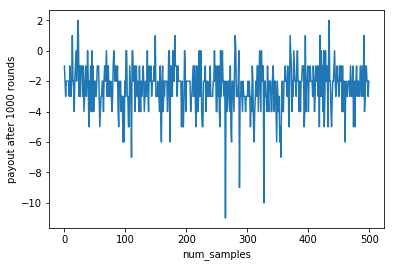

Average payout after 500 rounds is -2.38


In [25]:
plt_result(average_payouts,agent)

In [26]:
win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1

Initial state:  (18, 8, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (18, 8, False)
next obs (18, 8, False)
Initial state:  (9, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Hit
State after 1st action: (18, 10, False)
next obs (18, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (18, 10, False)
next obs (18, 10, False)
Initial state:  (21, 2, True)
------------------------------------------------------------------------------------

Hit
State after 1st action: (12, 3, False)
next obs (12, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 7
Random Initial Bet: 2
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (12, 3, False)
next obs (12, 3, False)
Initial state:  (10, 8, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Hit
State after 1st action: (20, 8, False)
next obs (20, 8, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 0
You have no money left! Will go to next game !!
Initial state:  (13, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 

Initial state:  (20, 5, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  0
Stay
player winner
State after 1st action: (20, 5, False)
next obs (20, 5, False)
Initial state:  (14, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Hit
State after 1st action: (21, 10, False)
next obs (21, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
Stay
player winner
State after 1st action: (21, 10, False)
next obs (21, 10, False)
Initial state:  (20, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Act

Initial state:  (6, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (6, 10, False)
next obs (6, 10, False)
Initial state:  (20, 10, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
Stay
Draw match
State after 1st action: (20, 10, True)
next obs (20, 10, True)
Initial state:  (21, 6, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  0
Stay
player winner
State after 1st action: (21, 6, True)
next obs (21, 6, True)
Initial state:  (17, 10, False)
-------------------------------------------------------------------------------------

Initial state:  (13, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (13, 7, False)
next obs (13, 7, False)
Initial state:  (8, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
Hit
State after 1st action: (19, 10, True)
next obs (19, 10, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 6
Random Initial Bet: 6
Action:  1
Hit
State after 1st action: (14, 10, False)
next obs (14, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 0
You have no money left! Will go to 

In [27]:
win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1

Initial state:  (8, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
Hit
State after 1st action: (16, 10, False)
next obs (16, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 4
Random Initial Bet: 1
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (16, 10, False)
next obs (16, 10, False)
Initial state:  (8, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Hit
State after 1st action: (16, 10, False)
next obs (16, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 1
You can bet only 1, so betting 

----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (16, 3, False)
next obs (16, 3, False)
Initial state:  (20, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  0
Stay
player winner
State after 1st action: (20, 7, False)
next obs (20, 7, False)
Initial state:  (15, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (15, 4, False)
next obs (15, 4, False)
Initial state:  (15, 5, False)
-----------------------------------------------------------------------

Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (25, 1, False)
next obs (25, 1, False)
Initial state:  (8, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Hit
State after 1st action: (19, 3, True)
next obs (19, 3, True)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 5
Random Initial Bet: 4
Action:  1
Hit
State after 1st action: (13, 3, False)
next obs (13, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (13, 3, False)
next obs (13, 3, False)
Initial state:  (17, 8, False)
------

Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (26, 6, False)
next obs (26, 6, False)
Initial state:  (16, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  1
Hit
State after 1st action: (18, 7, False)
next obs (18, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 9
Random Initial Bet: 5
Action:  1
Hit
State after 1st action: (20, 7, False)
next obs (20, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
Stay
player winner
State after 1st action: (20, 7, False)
next obs (20, 7, False)
Initial state:  (18, 7, False)
----------------------------------------------------------------------------------

Initial state:  (11, 3, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (11, 3, False)
next obs (11, 3, False)
Initial state:  (9, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
Hit
State after 1st action: (19, 4, False)
next obs (19, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 7
Random Initial Bet: 2
Action:  0
Stay
player winner
State after 1st action: (19, 4, False)
next obs (19, 4, False)
Initial state:  (13, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 mone

State after 1st action: (20, 1, False)
next obs (20, 1, False)
Initial state:  (11, 8, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 7
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (11, 8, False)
next obs (11, 8, False)
Initial state:  (12, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  1
Hit
State after 1st action: (19, 6, False)
next obs (19, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 9
Random Initial Bet: 8
Action:  0
Stay
player loser, wont get back the money, try next round
State after 1st action: (19, 6, False)
next obs (19, 6, False)
Initial state:  (12, 4, False)
------------------------

next obs (15, 9, False)
Initial state:  (20, 7, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
Stay
player winner
State after 1st action: (20, 7, False)
next obs (20, 7, False)
Initial state:  (13, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Hit
State after 1st action: (18, 10, False)
next obs (18, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 0
You have no money left! Will go to next game !!
Initial state:  (17, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  0
Stay
player loser, wont get back the

In [34]:
print("Winning : {} percentage".format(win/5))
print("Losing : {} percentage".format(loss/5))
print("Draw : {} percentage".format(draw/5))

Winning : 30.6 percentage
Losing : 55.8 percentage
Draw : 13.6 percentage


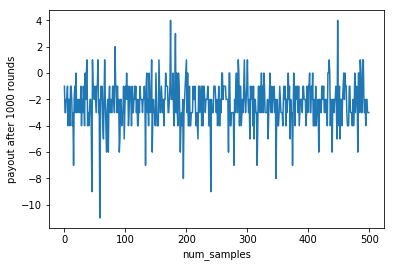

Average payout after 500 rounds is -2.302


In [36]:
plt_result(average_payouts,agent)

In [35]:
print(" Max Payout : {}".format(max(average_payouts)))

 Max Payout : 4.0


**Alpha (Learning rate):** It corresponds to the learning rate, higher the learning rate quicker the agent learns about the environment. But if the learning rate is to high the agent might not over learn.

As we can see in the plots the agent takes more time to learn when the alpha value is low (i.e. 0.1), where as it learns quickly when the learning rate is 0.8


## Final Results

## For Test Environment

In [30]:
env = BlackjackEnv()
player1 = Player('player1')
env.add_player(player1)

agent = RLAgent(env,player1.player_name)
num_rounds = 500
num_samples = 500
num_episodes_to_train = 0.8* num_rounds
#epsilon=1.0, alpha=0.8, gamma=0.1
average_payouts = agent.train(epsilon=1, alpha=0.7, gamma=0.15,num_rounds = num_rounds,num_samples = num_samples,num_episodes_to_train=num_episodes_to_train)
#print(average_payouts)
print("Max of Payouts: ", max(average_payouts))

Initial state:  (6, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  0
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (6, 10, False)
Next observation (6, 10, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 4
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (15, 6, False)
Next observation (15, 6, False)
Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (6, 6, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  8
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Rando

player name: player1 money left: 11
Random Initial Bet: 7
Action:  1
Remaining bet 4
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
Initial state:  (13, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 4
Random Initial Bet: 2
Action:  1
Remaining bet 2
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
Action:  1
Remaining bet 2
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  12
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
Initial state:  (18, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (9, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  20
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Remaining bet 2
State after 1st action: (19, 9, False)
Next observation (19, 9, False)
%%%%%%%%%%%%%%%%%%%%

Initial state:  (14, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  21
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (11, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 4
Random Initial Bet: 4
Action:  1
Remaining bet 0
State after 1st action: (13, 6, False)
Next observation (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Act

player winner
Remaining bet 2
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (6, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (6, 1, False)
Next observation (6, 1, False)
Initial state:  (6, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (6, 9, False)
Next observation (6, 9, False)
Initial state:  (11, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player

Remaining bet 20
State after 1st action: (4, 10, False)
Next observation (4, 10, False)
Initial state:  (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 20
Random Initial Bet: 9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (26, 2, False)
Next observation (26, 2, False)
Initial state:  (16, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 11
Random Initial Bet: 10
Action:  1
Remaining bet 1
State after 1st action: (19, 10, True)
Next observation (19, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
Remaining bet 1
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  7
player name: player1 money left: 8
Random Initial Bet: 5
Action:  1
Remaining bet 3
State after 1st action: (21, 7, False)
Next observation (21, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
player winner
Remaining bet 13
State after 1st action: (21, 7, False)
Next observation (21, 7, False)
Initial state:  (12, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 13
Random Initial Bet: 5
Action:  1
Remaining bet 8
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (19, 8, False)
Next observation (19, 8, False)
Initial state:  (14, 3, False)
%%%%%%%%%%%%%%%%%%%

Action:  1
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (23, 5, False)
Next observation (23, 5, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 26
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 34
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (17, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 34
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 29
State after 1st action: (17, 6, True)
Next observation (17, 6, True)
Initial state:  (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 29
Ran

Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 22
State after 1st action: (23, 1, False)
Next observation (23, 1, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  99
player name: player1 money left: 22
Random Initial Bet: 5
Action:  1
Remaining bet 17
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  99
Action:  0
player loser, wont get back the money, try next round
Remaining bet 17
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  100
player name: player1 money left: 17
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try nex

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 8
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 3, False)
Next observation (23, 3, False)
Initial state:  (14, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (9, 3, False)
Initial bet 10
--------------

Next observation (19, 10, True)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 17
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (19, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 8
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (27, 4, False)
Next observation (27, 4, False)
Initial state:  (20, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
Draw match
Remaining bet 2
State after 1st action: (

player loser, wont get back the money, try next round
Remaining bet 46
State after 1st action: (11, 7, False)
Next observation (11, 7, False)
Initial state:  (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 46
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 42
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
Initial state:  (17, 9, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
player name: player1 money left: 42
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 44
State after 1st action: (17, 9, True)
Next observation (17, 9, True)
Initial state:  (11, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 44
Random Initial

Next observation (24, 10, False)
Initial state:  (13, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 15
Random Initial Bet: 8
Action:  1
Remaining bet 7
State after 1st action: (21, 3, False)
Next observation (21, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 23
State after 1st action: (21, 3, False)
Next observation (21, 3, False)
Initial state:  (17, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 23
Random Initial Bet: 10
Action:  0
Draw match
Remaining bet 23
State after 1st action: (17, 2, True)
Next observation (17, 2, True)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Rou

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  38
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (26, 4, False)
Next observation (26, 4, False)
Initial state:  (13, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  39
player name: player1 money left: 6
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (23, 8, False)
Next observation (23, 8, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  40
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
Remaining bet 1
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
player loser, wont get back the money, try next round
Remaining bet 56
State after 1st action: (22, 6, False)
Next observation (22, 6, False)
Initial state:  (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 56
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 50
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
Initial state:  (21, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 50
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 56
State after 1st action: (21, 4, True)
Next observation (21, 4, True)
Initial state:  (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 56
Ran

Round:  7
player name: player1 money left: 10
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 16
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (19, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 16
Random Initial Bet: 8
Action:  0
player winner
Remaining bet 24
State after 1st action: (19, 5, True)
Next observation (19, 5, True)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 24
Random Initial Bet: 6
Action:  1
Remaining bet 18
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  0
player winner
Remaining bet 30
State after 1st action: (21, 10, False)
Next observa

Next observation (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  1
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (28, 10, False)
Next observation (28, 10, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 11
Random Initial Bet: 8
Action:  1
Remaining bet 3
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%


%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 2
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
Initial state:  (21, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (19, 1, False)
Next observation (19, 1, False)
Initial state:  (20, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Ra

Round:  15
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (17, 9, True)
Next observation (17, 9, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
Remaining bet 1
State after 1st action: (12, 9, False)
Next observation (12, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
Remaining bet 1
State after 1st action: (19, 9, False)
Next observation (19, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  0
player winner
Remaining bet 3
State after 1st action: (19, 9, False)
Next observation (19, 9, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 3
Random Initia

Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (29, 1, False)
Next observation (29, 1, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (9, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  89
----------------------------------------------------------------

Action:  1
Remaining bet 5
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (25, 10, False)
Next observation (25, 10, False)
Initial state:  (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 5
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 9
State after 1st action: (15, 3, False)
Next observation (15, 3, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  32
player name: player1 money left: 9
Random Initial Bet: 5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (23, 10, False)


Remaining bet 18
State after 1st action: (19, 6, False)
Next observation (19, 6, False)
Initial state:  (14, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 18
Random Initial Bet: 4
Action:  1
Remaining bet 14
State after 1st action: (21, 3, True)
Next observation (21, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player winner
Remaining bet 22
State after 1st action: (21, 3, True)
Next observation (21, 3, True)
Initial state:  (5, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 22
Random Initial Bet: 9
Action:  1
Remaining bet 13
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (14, 7, True)
Next observation (14, 7, True)
Initial state:  (16, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (26, 6, False)
Next observation (26, 6, False)
Initial state:  (17, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 3
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (17, 4, False)
Next observation (17, 4, False)
Initial state:  (15, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (12, 4, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  109
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Remaining bet 0
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
Draw match
Remaining bet 10
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (18, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player nam

Next observation (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (24, 9, False)
Next observation (24, 9, False)
Initial state:  (21, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 4
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (21, 6, True)
Next observation (21, 6, True)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 6
Random Initial Bet: 2
Action:  1
Remaining bet 4
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 0
State after 1st action: (19, 10, True)
Next observation (19, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (19, 10, True)
Next observation (19, 10, True)
Initial state:  (11, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (19, 6, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  118
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Init

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (16, 1, False)
Next observation (16, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (25, 1, False)
Next observation (25, 1, False)
Initial state:  (8, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (14, 3, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  126
------------------------------------------

Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
Initial state:  (15, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 3
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (15, 3, False)
Next observation (15, 3, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (11, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  130
----------------------------------------------------------------------------------------------------
%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
Remaining bet 0
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (17, 4, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  135
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  1
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (27, 7, False)
Next observation (27, 7, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 32
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 41
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 41
Random Initial Bet: 6
Action:  1
Remaining bet 35
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action

Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 22
Random Initial Bet: 3
Action:  0
Draw match
Remaining bet 22
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (12, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 22
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 27
State after 1st action: (12, 3, False)
Next observation (12, 3, False)
Initial state:  (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 27
Random Initial Bet: 1
Action:  1
Remaining bet 26
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 17
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 17
State after 1st action: (28, 5, False)
Next observation (28, 5, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 17
Random Initial Bet: 6
Action:  0
Draw match
Remaining bet 17
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 17
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 26
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (20, 2

Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (27, 10, False)
Next observation (27, 10, False)
Initial state:  (18, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 4
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (18, 1, True)
Next observation (18, 1, True)
Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (17, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  162
----------------------------------------------------------------------------------------------------
%%%%%%

Remaining bet 7
State after 1st action: (8, 10, False)
Next observation (8, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
Remaining bet 7
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
Initial state:  (6, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 7
Random Initial Bet: 2
Action:  1
Remaining bet 5
State after 1st action: (16, 6, False)
Next observation (16, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remai

Action:  0
player winner
Remaining bet 10
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 10
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (23, 6, False)
Next observation (23, 6, False)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 4
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 6
State after 1st action: (11, 7, False)
Next observation (11, 7, False)
Initial state:  (11, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 6
Random Initial Bet: 6
Action:  1
Remaining 

Round:  8
player name: player1 money left: 3
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (25, 1, False)
Next observation (25, 1, False)
Initial state:  (12, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 1, False)
Next observation (23, 1, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 0
You

Round:  1
player name: player1 money left: 10
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (8, 9, False)
Next observation (8, 9, False)
Initial state:  (12, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 6
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (12, 10, True)
Next observation (12, 10, True)
Initial state:  (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 5
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 10
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (14, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 12
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (28, 10, False)
Next observation (28, 10, False)
Initial state:  (10, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 6
Random Initial Bet: 1
Action:  1
Remaining bet 5
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
player winner
Remaining bet 7
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (16, 6, True)
Next observation (16, 6, True)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 8
Random Initial Bet: 7
Action:  1
Remaining bet 1
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
Remaining bet 1
State after 1st action: (15, 10, False)
Next observation (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
Remaining bet 1
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player

Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (29, 10, False)
Next observation (29, 10, False)
Initial state:  (8, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (10, 7, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  195
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 9
Action:  1
Remaining bet 1
State after 1st action: (21, 7, True)
Next observation (21, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  42
player name: player1 money left: 44
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 34
State after 1st action: (30, 1, False)
Next observation (30, 1, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  43
player name: player1 money left: 34
Random Initial Bet: 8
Action:  1
player loser, wont get back the money, try next round
Remaining bet 26
State after 1st action: (28, 10, False)
Next observation (28, 10, False)
Initial state:  (5, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  44
player name: player1 money left: 26
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 31
State after 1st action: (5, 2, False)
Next observation (5, 2, False)
Initial state:  (9, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (14, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 20
Random Initial Bet: 9
Action:  0
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (14, 8, False)
Next observation (14, 8, False)
Initial state:  (12, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 11
Random Initial Bet: 6
Action:  1
Remaining bet 5
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (26, 1, False)
Next observation (26, 1, False)
Initial state:  (7, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (11, 6, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  203
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Remaining bet 3
State after 1st action: (12, 6, False)
Next observation (12, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (20, 5, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
player name: player1 money left: 30
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 33
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 33
Random Initial Bet: 3
Action:  1
Remaining bet 30
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
Action:  0
player winner
Remaining bet 36
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (15, 5, False)
Next observation (15, 5, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 14
Random Initial Bet: 9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (18, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 5
Random Initial Bet: 3
Action:  1
Remaining bet 2
State after 1st action: (16, 3, False)
Next observation (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
Stat

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 36
Random Initial Bet: 4
Action:  1
Remaining bet 32
State after 1st action: (12, 10, False)
Next observation (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 32
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (11, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 32
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 33
State after 1st action: (11, 5, False)
Next observation (11, 5, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player na

Next observation (16, 10, False)
Initial state:  (19, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 3
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (28, 2, False)
Next observation (28, 2, False)
Initial state:  (13, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (17, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  219
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: 

Round:  15
player name: player1 money left: 16
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (17, 8, True)
Next observation (17, 8, True)
Initial state:  (15, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (24, 1, False)
Next observation (24, 1, False)
Initial state:  (15, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (11, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  221
----------------------------------

Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
Action:  0
player winner
Remaining bet 2
State after 1st action: (21, 4, False)
Next observation (21, 4, False)
Initial state:  (13, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (13, 2, False)
Next observation (13, 2, False)
Initial state:  (17, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (8, 10, False)
Initial bet 10
-------------------------------

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (12, 1, False)
Next observation (12, 1, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 3
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (10, 8, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game nu

Initial state:  (11, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 25
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 19
State after 1st action: (11, 4, False)
Next observation (11, 4, False)
Initial state:  (13, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 19
Random Initial Bet: 9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 10
State after 1st action: (23, 8, False)
Next observation (23, 8, False)
Initial state:  (14, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 10
Random Initial Bet: 3
Action:  1
Remaining bet 7
State after 1st action: (17, 5, False)
Next observation (17, 5, Fal

Remaining bet 40
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (18, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 40
Random Initial Bet: 4
Action:  1
Remaining bet 36
State after 1st action: (21, 6, False)
Next observation (21, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
Action:  0
player winner
Remaining bet 44
State after 1st action: (21, 6, False)
Next observation (21, 6, False)
Initial state:  (6, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 44
Random Initial Bet: 5
Action:  1
Remaining bet 39
State after 1st action: (8, 5, False)
Next observation (8, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 12
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (16, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 12
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (25, 6, False)
Next observation (25, 6, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 8
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 9
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (11, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 9
Random Initial Bet: 7
Action:  1
Remaining bet 2
State after 1st ac

Next observation (23, 7, False)
Initial state:  (10, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 9
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (10, 2, False)
Next observation (10, 2, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 3
Random Initial Bet: 3
Action:  1
Remaining bet 0
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 6
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (22, 10, False)
Initial state:  (16, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 15
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (26, 5, False)
Next observation (26, 5, False)
Initial state:  (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 14
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 8
State after 1st action: (26, 1, False)
Next observation (26, 1, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 8
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 11
State after 1st ac

Remaining bet 0
State after 1st action: (19, 4, True)
Next observation (19, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
Action:  0
player winner
Remaining bet 12
State after 1st action: (19, 4, True)
Next observation (19, 4, True)
Initial state:  (12, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 12
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 14
State after 1st action: (12, 6, True)
Next observation (12, 6, True)
Initial state:  (17, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 14
Random Initial Bet: 3
Action:  1
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (25, 7, False)
Next observation (25, 7, False)
Initial state:  (12, 10, False

Next observation (21, 6, True)
Initial state:  (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 4
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (13, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
Remaining bet 3
State after 1st action: (17, 7, False)
Next observation (17, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  1
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (25, 7, False)
Next observation (25, 7, False)
Initial state:  (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 8
State after 1st action: (24, 9, False)
Next observation (24, 9, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 8
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 14
State after 1st action: (7, 10, False)
Next observation (7, 10, False)
Initial state:  (16, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 14
Random Initial Bet: 8
Action:  1
Remaining bet 6
State after 1st action: (17, 9, False)
Next observation (17, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  1
Remaining bet 6
State after 1st action: (21, 9, False)
Next observation (21, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player winner
Remaining bet 35
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 35
Random Initial Bet: 3
Action:  1
Remaining bet 32
State after 1st action: (13, 10, False)
Next observation (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
Remaining bet 32
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 38
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (16, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
playe

Round:  5
Action:  1
Remaining bet 4
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (21, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
Remaining bet 3
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  0
Draw match
Remaining bet 4
State after 1st action: (18, 4, False)
Next observation (18, 4, False)
Initial state:  (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  1
Remaining bet 17
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  59
Action:  0
player winner
Remaining bet 31
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (13, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  60
player name: player1 money left: 31
Random Initial Bet: 2
Action:  1
Remaining bet 29
State after 1st action: (18, 5, False)
Next observation (18, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  60
Action:  1
player loser, wont get back the money, try next round
Remaining bet 29
State after 1st action: (26, 5, False)
Next observation (26, 5, False)
Initial state:  (11, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (21, 10, True)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 28
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 27
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
Initial state:  (13, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 27
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 25
State after 1st action: (13, 10, True)
Next observation (13, 10, True)
Initial state:  (17, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 25
Random Initial Bet: 10
Action:  0
Draw match
Remaining bet 25
State after 1st acti

Initial state:  (20, 5, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  290
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  0
player winner
Remaining bet 20
State after 1st action: (20, 5, False)
Next observation (20, 5, False)
Initial state:  (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 20
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 16
State after 1st action: (22, 5, False)
Next observation (22, 5, False)
Initial state:  (12, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Game number:  294
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 6
State after 1st action: (23, 6, False)
Next observation (23, 6, False)
Initial state:  (19, 6, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 6
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 8
State after 1st action: (19, 6, True)
Next observation (19, 6, True)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 8
Random Initial Bet: 8
Action:  0
player loser, wont get back the money, try

Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 15
Random Initial Bet: 6
Action:  1
Remaining bet 9
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player winner
Remaining bet 21
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (5, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 21
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 18
State after 1st action: (5, 6, False)
Next observation (5, 6, False)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (19, 7, False)
Initial state:  (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
player name: player1 money left: 33
Random Initial Bet: 5
Action:  0
player winner
Remaining bet 38
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (20, 3, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  30
player name: player1 money left: 38
Random Initial Bet: 6
Action:  0
Draw match
Remaining bet 38
State after 1st action: (20, 3, True)
Next observation (20, 3, True)
Initial state:  (10, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  31
player name: player1 money left: 38
Random Initial Bet: 7
Action:  1
Remaining bet 31
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Round:  56
player name: player1 money left: 12
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 18
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (14, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  57
player name: player1 money left: 18
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (14, 1, True)
Next observation (14, 1, True)
Initial state:  (14, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  58
player name: player1 money left: 12
Random Initial Bet: 2
Action:  1
Remaining bet 10
State after 1st action: (18, 2, False)
Next observation (18, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  58
Action:  0
player loser, wont get back the money, try n

Remaining bet 8
State after 1st action: (12, 7, False)
Next observation (12, 7, False)
Initial state:  (4, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 8
Random Initial Bet: 4
Action:  1
Remaining bet 4
State after 1st action: (15, 2, True)
Next observation (15, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  1
Remaining bet 4
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (15, 2, False)
Next observation (15, 2, False)
Initial state:  (20, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
playe

State after 1st action: (24, 10, False)
Next observation (24, 10, False)
Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  318
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Remaining bet 0
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  1
Remaining bet 0
State after 1st action: (1

Round:  3
player name: player1 money left: 3
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 5
State after 1st action: (19, 7, False)
Next observation (19, 7, False)
Initial state:  (21, 9, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 5
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 8
State after 1st action: (21, 9, True)
Next observation (21, 9, True)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 8
Random Initial Bet: 2
Action:  0
Draw match
Remaining bet 8
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (13, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 8
Random Initial Bet: 5
Act

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 6
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 9
State after 1st action: (17, 8, False)
Next observation (17, 8, False)
Initial state:  (15, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 9
Random Initial Bet: 5
Action:  0
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (15, 6, False)
Next observation (15, 6, False)
Initial state:  (12, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 4
Random Initial Bet: 1
Action:  1
Remaining bet 3
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (12, 7, False)
Next observation (12, 7, False)
Initial state:  (18, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 3
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 4
State after 1st action: (18, 8, False)
Next observation (18, 8, False)
Initial state:  (12, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 7
State after 1st action: (12, 7, False)
Next observation (12, 7, False)
Initial state:  (15, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  21
player name: player1 money left: 7
Random Initial Bet: 1
Action:  0
player loser,

player name: player1 money left: 17
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (13, 9, False)
Next observation (13, 9, False)
Initial state:  (17, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 13
Random Initial Bet: 9
Action:  1
player loser, wont get back the money, try next round
Remaining bet 4
State after 1st action: (27, 5, False)
Next observation (27, 5, False)
Initial state:  (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 4
Random Initial Bet: 3
Action:  0
player winner
Remaining bet 7
State after 1st action: (17, 6, False)
Next observation (17, 6, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (16, 1, False)
Next observation (16, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (26, 1, False)
Next observation (26, 1, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (22, 4, False)
Next observation (22, 4, False)
Initial state:  (15, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (21, 10, True)
Initial b

Remaining bet 18
State after 1st action: (17, 10, False)
Next observation (17, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  1
Remaining bet 18
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
Action:  0
Draw match
Remaining bet 25
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (5, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 25
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 24
State after 1st action: (5, 3, False)
Next observation (5, 3, False)
Initial state:  (13, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Next observation (23, 10, False)
Initial state:  (15, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (17, 2, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  349
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (17, 2, False)
Next observation (17, 2, False)
Initial state:  (7, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: p

Next observation (14, 5, False)
Initial state:  (14, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (21, 5, False)
Next observation (21, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 5, False)
Next observation (23, 5, False)
Initial state:  (11, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (18, 9, False)
Initial bet 10
----------------------------------------------------------------------------------------------

Next observation (16, 5, False)
Initial state:  (7, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (14, 7, True)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  366
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Remaining bet 5
State after 1st action: (14, 7, False)
Next observation (14, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 5
State after 1st act

Remaining bet 0
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 20
State after 1st action: (20, 2, False)
Next observation (20, 2, False)
Initial state:  (12, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 20
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 18
State after 1st action: (22, 1, False)
Next observation (22, 1, False)
Initial state:  (6, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 18
Random Initial Bet: 6
Action:  1
Remaining bet 12
State after 1st action: (16, 6, False)
Next observation (16, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 1
State after 1st action: (27, 10, False)
Next observation (27, 10, False)
Initial state:  (9, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (18, 1, False)
Next observation (18, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 1, False)
Next observation (23, 1, False)
Initial state:  (6, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 10, False)
Initial bet 10
-----------------------------------------

Action:  0
player winner
Remaining bet 34
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (15, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  27
player name: player1 money left: 34
Random Initial Bet: 10
Action:  0
player loser, wont get back the money, try next round
Remaining bet 24
State after 1st action: (15, 4, False)
Next observation (15, 4, False)
Initial state:  (10, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  28
player name: player1 money left: 24
Random Initial Bet: 9
Action:  0
player winner
Remaining bet 33
State after 1st action: (10, 10, False)
Next observation (10, 10, False)
Initial state:  (5, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  29
player name: player1 money left: 33
Random Initial Bet: 3
Action:  0
pla

Round:  15
player name: player1 money left: 5
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 6
State after 1st action: (14, 2, False)
Next observation (14, 2, False)
Initial state:  (20, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 6
Random Initial Bet: 2
Action:  0
Draw match
Remaining bet 6
State after 1st action: (20, 8, False)
Next observation (20, 8, False)
Initial state:  (16, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  17
player name: player1 money left: 6
Random Initial Bet: 4
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (16, 8, False)
Next observation (16, 8, False)
Initial state:  (17, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: pla

Random Initial Bet: 7
Action:  0
player loser, wont get back the money, try next round
Remaining bet 2
State after 1st action: (11, 4, False)
Next observation (11, 4, False)
Initial state:  (21, 8, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
player name: player1 money left: 2
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 4
State after 1st action: (21, 8, True)
Next observation (21, 8, True)
Initial state:  (14, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
player name: player1 money left: 4
Random Initial Bet: 3
Action:  1
Remaining bet 1
State after 1st action: (21, 2, True)
Next observation (21, 2, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  8
Action:  1
Remaining bet 1
State after 1st action: (16, 2, False)
Next observation (16, 2, False)
%%%%%%%%%%%%%%%

Action:  0
Draw match
Remaining bet 2
State after 1st action: (21, 1, False)
Next observation (21, 1, False)
Initial state:  (18, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  1
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (19, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (19, 4, False)
Next observation (19

Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (20, 6, False)
Next observation (20, 6, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (20, 9, False)
Next observation (20, 9, False)
Initial state:  (19, 6, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 2
Random Initial Bet: 2
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (27, 6, False)
Next observation (27, 6, False)
Initial state:  (20, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
playe

Next observation (20, 3, False)
Initial state:  (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 5
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial state:  (4, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 3
Random Initial Bet: 1
Action:  1
Remaining bet 2
State after 1st action: (15, 4, True)
Next observation (15, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Action:  1
Remaining bet 2
State after 1st action: (17, 4, True)
Next observation (17, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
Actio

Remaining bet 17
State after 1st action: (12, 7, False)
Next observation (12, 7, False)
Initial state:  (16, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  9
player name: player1 money left: 17
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 11
State after 1st action: (16, 7, True)
Next observation (16, 7, True)
Initial state:  (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
player name: player1 money left: 11
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 7
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (20, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 7
Random Initial Bet: 6
Action

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  10
Action:  0
player winner
Remaining bet 44
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  11
player name: player1 money left: 44
Random Initial Bet: 6
Action:  0
Draw match
Remaining bet 44
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (21, 4, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
player name: player1 money left: 44
Random Initial Bet: 2
Action:  1
Remaining bet 42
State after 1st action: (12, 4, False)
Next observation (12, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  12
Action:  1
Remaining bet 42
State after 1st action:

Remaining bet 0
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 20
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (17, 1, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 20
Random Initial Bet: 6
Action:  0
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (17, 1, False)
Next observation (17, 1, False)
Initial state:  (18, 5, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 14
Random Initial Bet: 4
Action:  0
player winner
Remaining bet 18
State after 1st action: (18, 5, True)
Next observation (18, 5, True)
Initial state:  (12, 10, F

player name: player1 money left: 27
Random Initial Bet: 2
Action:  1
Remaining bet 25
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
Action:  1
player loser, wont get back the money, try next round
Remaining bet 25
State after 1st action: (22, 10, False)
Next observation (22, 10, False)
Initial state:  (16, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
player name: player1 money left: 25
Random Initial Bet: 10
Action:  1
Remaining bet 15
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  20
Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (17, 3, False)
Next observation (17, 3, False)
Initial 

Action:  1
Remaining bet 0
State after 1st action: (14, 10, False)
Next observation (14, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  34
Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (14, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  35
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (20, 10, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  435
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money le

Remaining bet 2
State after 1st action: (12, 1, False)
Next observation (12, 1, False)
Initial state:  (6, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 2
Random Initial Bet: 1
Action:  1
Remaining bet 1
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (14, 9, False)
Next observation (14, 9, False)
Initial state:  (16, 7, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (16, 7, T

Remaining bet 14
State after 1st action: (27, 8, False)
Next observation (27, 8, False)
Initial state:  (13, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 14
Random Initial Bet: 1
Action:  1
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (18, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
player name: player1 money left: 13
Random Initial Bet: 6
Action:  1
Remaining bet 7
State after 1st action: (20, 1, True)
Next observation (20, 1, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  4
Action:  0
player winner
Remaining bet 19
State after 1st action: (20, 1, True)
Next observation (20, 1, True)
Initial state:  (13, 10, True)
%%%%%%%%

Remaining bet 1
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
Action:  0
player winner
Remaining bet 19
State after 1st action: (21, 10, False)
Next observation (21, 10, False)
Initial state:  (11, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  2
player name: player1 money left: 19
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 17
State after 1st action: (11, 7, False)
Next observation (11, 7, False)
Initial state:  (15, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  3
player name: player1 money left: 17
Random Initial Bet: 4
Action:  1
player loser, wont get back the money, try next round
Remaining bet 13
State after 1st action: (24, 10, False)
Next obse

Remaining bet 14
State after 1st action: (17, 5, False)
Next observation (17, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
Remaining bet 14
State after 1st action: (18, 5, False)
Next observation (18, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  1
player loser, wont get back the money, try next round
Remaining bet 14
State after 1st action: (26, 5, False)
Next observation (26, 5, False)
Initial state:  (16, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 14
Random Initial Bet: 2
Action:  0
player winner
Remaining bet 16
State after 1st action: (16, 2, False)
Next observation (16, 2, False)
Initial state:  (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

player winner
Remaining bet 8
State after 1st action: (20, 3, False)
Next observation (20, 3, False)
Initial state:  (17, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 8
Random Initial Bet: 8
Action:  1
Remaining bet 0
State after 1st action: (21, 8, False)
Next observation (21, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
Action:  0
player winner
Remaining bet 16
State after 1st action: (21, 8, False)
Next observation (21, 8, False)
Initial state:  (9, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 16
Random Initial Bet: 4
Action:  1
Remaining bet 12
State after 1st action: (12, 5, False)
Next observation (12, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 3
State after 1st action: (18, 7, False)
Next observation (18, 7, False)
Initial state:  (15, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  18
player name: player1 money left: 3
Random Initial Bet: 2
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (15, 4, False)
Next observation (15, 4, False)
Initial state:  (11, 5, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  19
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 2
State after 1st action: (11, 5, False)
Next observation (11, 5, False)
Initial state:  (13, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Remaining bet 1
State after 1st action: (25, 1, False)
Next observation (25, 1, False)
Initial state:  (15, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  1
Remaining bet 0
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
Action:  0
player winner
Remaining bet 2
State after 1st action: (20, 7, False)
Next observation (20, 7, False)
Initial state:  (15, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  16
player name: player1 money left: 2
Random Initial Bet: 1
Action:  0
player winner
Remaining bet 3
State after 1st action: (15, 4, False)
Next observation (15, 4, False)
Initial state:  (7, 10, False)
%%%%%%%%%

player name: player1 money left: 24
Random Initial Bet: 9
Action:  1
Remaining bet 15
State after 1st action: (11, 10, False)
Next observation (11, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  1
Remaining bet 15
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
Action:  0
player loser, wont get back the money, try next round
Remaining bet 15
State after 1st action: (16, 10, False)
Next observation (16, 10, False)
Initial state:  (9, 8, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 15
Random Initial Bet: 3
Action:  0
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (9, 8, False)
Next observation (9, 8, False)
Initial st

Remaining bet 18
State after 1st action: (19, 10, False)
Next observation (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
Action:  1
Remaining bet 18
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  22
Action:  0
player winner
Remaining bet 28
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (11, 2, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  23
player name: player1 money left: 28
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 34
State after 1st action: (11, 2, False)
Next observation (11, 2, False)
Initial state:  (9, 9, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  24
player name: p

Action:  1
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (23, 7, False)
Next observation (23, 7, False)
Initial state:  (16, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 0
You have no money left ! Will go to next game !!
Initial state:  (13, 3, False)
Initial bet 10
----------------------------------------------------------------------------------------------------
Game number:  488
----------------------------------------------------------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  1
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
Remaining bet 6
State after 1st action: (14, 3, False)
Next observation (14, 3, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Initial state:  (21, 10, True)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  13
player name: player1 money left: 12
Random Initial Bet: 6
Action:  0
player winner
Remaining bet 18
State after 1st action: (21, 10, True)
Next observation (21, 10, True)
Initial state:  (19, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  14
player name: player1 money left: 18
Random Initial Bet: 6
Action:  1
player loser, wont get back the money, try next round
Remaining bet 12
State after 1st action: (23, 10, False)
Next observation (23, 10, False)
Initial state:  (13, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  15
player name: player1 money left: 12
Random Initial Bet: 9
Action:  1
Remaining bet 3
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%

Action:  0
player winner
Remaining bet 9
State after 1st action: (20, 4, False)
Next observation (20, 4, False)
Initial state:  (20, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  5
player name: player1 money left: 9
Random Initial Bet: 8
Action:  0
player loser, wont get back the money, try next round
Remaining bet 1
State after 1st action: (20, 10, False)
Next observation (20, 10, False)
Initial state:  (9, 7, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  6
player name: player1 money left: 1
You can bet only 1, so betting only 1.
Random Initial Bet: 1
Action:  0
player loser, wont get back the money, try next round
Remaining bet 0
State after 1st action: (9, 7, False)
Next observation (9, 7, False)
Initial state:  (7, 10, False)
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Round:  7
playe

In [32]:
win = 0
loss = 0
draw = 0    
for i in range(500):
    output = agent.test()
    if(output > 0):
        win += 1
    if(output < 0):
        loss += 1
    if(output == 0):
        draw += 1

Initial state:  (20, 1, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 8
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (28, 1, False)
next obs (28, 1, False)
Initial state:  (12, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 7
Action:  1
Hit
State after 1st action: (16, 10, False)
next obs (16, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 3
Random Initial Bet: 2
Action:  0
Stay
player winner
State after 1st action: (16, 10, False)
next obs (16, 10, False)
Initial state:  (21, 4, True)
----------------------------------------------------------------------------------------------------
player name: player1 mo

----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
Stay
player winner
State after 1st action: (20, 2, False)
next obs (20, 2, False)
Initial state:  (16, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 4
Action:  1
Hit
State after 1st action: (19, 6, False)
next obs (19, 6, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 6
Random Initial Bet: 3
Action:  0
Stay
player winner
State after 1st action: (19, 6, False)
next obs (19, 6, False)
Initial state:  (20, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 2
Action:  0
Stay
player loser, wont get

Action:  1
Hit
State after 1st action: (17, 9, False)
next obs (17, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 0
You have no money left! Will go to next game !!
Initial state:  (12, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Hit
State after 1st action: (20, 9, False)
next obs (20, 9, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 5
Random Initial Bet: 5
Action:  0
Stay
player winner
State after 1st action: (20, 9, False)
next obs (20, 9, False)
Initial state:  (7, 5, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 1
Action:  0
Stay
player loser, 

next obs (21, 3, True)
Initial state:  (13, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 5
Action:  1
Hit
player loser, wont get back the money, try next round
State after 1st action: (23, 10, False)
next obs (23, 10, False)
Initial state:  (20, 4, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 9
Action:  0
Stay
player winner
State after 1st action: (20, 4, False)
next obs (20, 4, False)
Initial state:  (13, 10, False)
----------------------------------------------------------------------------------------------------
player name: player1 money left: 10
Random Initial Bet: 10
Action:  1
Hit
State after 1st action: (16, 10, False)
next obs (16, 10, False)
-------------------------------------------------------------------------------------------------

In [ ]:
print(" Max Payout : {}".format(max(average_payouts)))

# IV - Results

* We can see in the plots the agent takes more time to learn when the alpha value is low (i.e. 0.1), where as it learns quickly when the learning rate is 0.8
* We can see that a low gamma value of 0.01, 0.1 makes the agent to just avoid the next wall without thinking about the future reward where as a high gamma value of 0.9 will make the agent to avoid the wall and also move towards the goal.

# V. Conclusions

It was a fun assignment. 
We learned how machine learning algorithms can be applied to real world problems.
It helped to learn RL in a better way by solving the real world situations.
The challenge that I faced was to create Q table for the BlackJack problem. It was also challenging to write the RL agent and betting part of the algorithm.
Now I can try to apply reinforcement learning to other similar gaming problems.

# Extra Credit for Tournament Top16!

- In two classes, we will have qualification and tournament.
- In qualification game, individual will play against a dealer for one game for 50 round. 
  - Highly ranked (by the profit) and non-broke players will proceed to the tournament.
  - max. 32 players will be cut for main tournament.
- In tournament, 4 players will be play in each round.
  - In a table game, the game lasts until two players broke
  - In final, the game will ends in 50 rounds and winner will be the one with highest balance. 

## Grading

We will test your notebook with an additional grid.txt file. Please make sure to test in different maze input files. 

points | | description
--|--|:--
5 | Overview| states the objective and the appraoch 
35 | Methods | 
 |10| Review of the SARSA and Q-Learning
 | 5| Choice of TD learning and Reason
 | 5| Choice of Function Approximation and Reason
 |10| Implementation of the selected approach (RLAgent)
 | 5| explanation of the codes
45 | Results 
 |10| Reports the selected parameters 
 |15| Experimental outputs that show the choice of parameters. How do you choose them?
 |10| Output plots (5 for each)
 |10| reading and analysis of learning results and plots
10 | Participation to the tournament.
5 | Conclusions 


## References

1. https://nbviewer.jupyter.org/url/webpages.uncc.edu/mlee173/teach/itcs6156/notebooks/notes/Note-ReinforcementLearning.ipynb
2. https://github.com/koreykiran/MachineLearning
3. http://incompleteideas.net/book/ebook/pseudotmp8.png
4. http://incompleteideas.net/book/ebook/pseudotmp9.png
5. https://stats.stackexchange.com/questions/270618/why-does-q-learning-use-epsilon-greedy-during-testing
6. https://medium.freecodecamp.org/diving-deeper-into-reinforcement-learning-with-q-learning-c18d0db58efe
7. https://studywolf.wordpress.com/2012/11/25/reinforcement-learning-q-learning-and-exploration/
8. https://www.youtube.com
9. https://www.cse.unsw.edu.au/~cs9417ml/RL1/tdlearning.html

